<a href="https://colab.research.google.com/github/arthurw125/GAN_Research/blob/main/Set_Discriminator_Conditioned_CycleGAN_MultCycle_3to1_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Uses 3 Camera Views to Reproduce the Missing 4th Camera View (Multiple Generators and Discriminators) A conditioned GAN with Adversarial Loss on the Set. Adds noise to the Generator

## Setup

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
!pip install tensorflow_addons
import tensorflow_addons as tfa
import tensorflow_datasets as tfds

tfds.disable_progress_bar()
autotune = tf.data.AUTOTUNE

import json
import cv2

     |████████████████████████████████| 1.1 MB 16.1 MB/s 


In [ ]:
class DataReader:

    def __init__(self, image_dir, label_dir, num_cam, start_frame=0, end_frame=0, save_videos=False):
        self._image_dir = image_dir
        self._label_dir = label_dir
        self._num_cam = num_cam
        self._start_frame = start_frame
        self._end_frame = end_frame
        self._save_videos = save_videos

        if self._save_videos:
            self._rgb_videos = {}
            for cam_id in range(1, self._num_cam+1):
                self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.avi', cv2.VideoWriter_fourcc(*'MJPG'), 15, (640, 360))
                #self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.mp4', cv2.VideoWriter_fourcc(*'mp4v'), 15, (640, 360))
                #self._rgb_videos[cam_id] = cv2.VideoWriter('video_camera_view_'+str(cam_id)+'.mov', cv2.VideoWriter_fourcc(*'H264'), 15, (640, 360))
    def __del__(self):
        if self._save_videos:
            for _, out_video in self._rgb_videos.items():
                out_video.release()

    def read(self, frame_id):
        rgbs = {}
        labels = {}
        for cam_id in range(1, self._num_cam+1):
            rgb = cv2.imread(os.path.join(self._image_dir, 'rgb_'+str(frame_id).zfill(5)+'_'+str(cam_id)+'.jpg'), cv2.IMREAD_UNCHANGED)
            label = json.load(open(os.path.join(self._label_dir, 'rgb_'+str(frame_id).zfill(5)+'_'+str(cam_id)+'.json')))
            rgbs[cam_id] = rgb
            labels[cam_id] = label

        return rgbs, labels
    
    def plot(self):
        for frame_id in range(self._start_frame, self._end_frame):
            rgbs, labels = self.read(frame_id)
            for cam_id in range(1, self._num_cam+1):
                rgb = rgbs[cam_id]
                tracklet = labels[cam_id]
                '''
                //code for adding bounding box around the people
                for id, (x_min, y_min, x_max, y_max) in tracklet.items():
                    rgb = cv2.rectangle(rgb, (int(x_min), int(y_min)), (int(x_max), int(y_max)), (0, 0, 255), 2)
                    rgb = cv2.putText(rgb, str(id), (int(x_min), int(y_min)), cv2.FONT_HERSHEY_PLAIN, 2, (0, 255, 0), 2, cv2.LINE_AA)
                rgb = cv2.putText(rgb, str(frame_id), (30, 30), cv2.FONT_HERSHEY_PLAIN, 1, (255, 255, 0), 2, cv2.LINE_AA)
                '''
                if self._save_videos:
                    self._rgb_videos[cam_id].write(rgb)

In [ ]:
def img_seq_resize(data, start, end):
  rows = []
  for i in range(start,end):
    img = tf.image.resize(data[:,i,...], [100, 100],preserve_aspect_ratio=True,method=tf.image.ResizeMethod.BILINEAR)
    rows.append(img)
  img_seq = tf.stack(rows, axis=1)
  return img_seq

In [ ]:
def create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame):
    my_data = []
    my_labels = []
    count = 0
    data_reader = DataReader(image_dir, label_dir, num_cam, start_frame, end_frame, False)
    for frame_id in range(start_frame, end_frame):
        data, labels = data_reader.read(frame_id)
        my_list = list(data.values())
        my_list = np.array(my_list)
        my_data.append(my_list)
        my_labels.append(labels)
        if count % 100 == 0:
          print('frame_id:',frame_id)
        count += 1
    my_data = np.array(my_data)
    my_labels = np.array(my_labels)
    cyc_data = {'A': tf.data.Dataset.from_tensor_slices(img_seq_resize(my_data, 0, 3)),
                'B': tf.data.Dataset.from_tensor_slices(img_seq_resize(my_data, 3, 4))}
  
    return cyc_data, my_labels 

## Prepare the dataset



In [ ]:

image_dir = '/content/drive/MyDrive/Research/train/images/63am/cafe_shop_0'
label_dir = '/content/drive/MyDrive/Research/train/labels/63am/cafe_shop_0'
num_cam = 4

start_frame, end_frame = 0, 500
dataset_train, _ = create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame)
#dataset_train = tf.data.Dataset.from_tensor_slices(dataset_train)
start_frame, end_frame = 500, 700
dataset_test, _ = create_dataset(image_dir, label_dir, num_cam, start_frame, end_frame)
#dataset_test = tf.data.Dataset.from_tensor_slices(dataset_test)


frame_id: 0
frame_id: 100
frame_id: 200
frame_id: 300
frame_id: 400
frame_id: 500
frame_id: 600


In [ ]:
print(dataset_train)
print(dataset_test)
train_angles_3, train_angles_1 = dataset_train['A'], dataset_train['B']
test_angles_3, test_angles_1 = dataset_test['A'], dataset_test['B']
# Define the standard image size.
orig_img_size = (360, 640)
# Size of the random crops to be used during training.
input_img_size = (45, 80, 3)
# Weights initializer for the layers.
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

#buffer_size = 256
buffer_size = 256
batch_size = 8


def normalize_img(img):
    img = tf.cast(img, dtype=tf.float32)
    # Map values in the range [-1, 1]
    return (img / 127.5) - 1.0


def preprocess_train_image(img):
    # Random flip
    #img = tf.image.random_flip_left_right(img)
    # Resize to the original size first
    #img = tf.image.resize(img, [*orig_img_size])
    # Random crop to 256X256
    #img = tf.image.random_crop(img, size=[*input_img_size])
    # Normalize the pixel values in the range [-1, 1]
    img = normalize_img(img)
    return img


def preprocess_test_image(img):
    # Only resizing and normalization for the test images.
    #img = tf.image.resize(img, [input_img_size[0], input_img_size[1]])
    img = normalize_img(img)
    return img


{'A': <TensorSliceDataset element_spec=TensorSpec(shape=(3, 56, 100, 3), dtype=tf.float32, name=None)>, 'B': <TensorSliceDataset element_spec=TensorSpec(shape=(1, 56, 100, 3), dtype=tf.float32, name=None)>}
{'A': <TensorSliceDataset element_spec=TensorSpec(shape=(3, 56, 100, 3), dtype=tf.float32, name=None)>, 'B': <TensorSliceDataset element_spec=TensorSpec(shape=(1, 56, 100, 3), dtype=tf.float32, name=None)>}


In [ ]:
dataset_train['A']
# original img size (360, 640, 3)

<TensorSliceDataset element_spec=TensorSpec(shape=(3, 56, 100, 3), dtype=tf.float32, name=None)>

In [ ]:
dataset_train['B']

<TensorSliceDataset element_spec=TensorSpec(shape=(1, 56, 100, 3), dtype=tf.float32, name=None)>

## Create `Dataset` objects

In [ ]:
#train_angles_3.shape, train_angles_1.shape

In [ ]:
batch_size = 16

In [ ]:

train_angles_3 = (
    train_angles_3.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)
train_angles_1 = (
    train_angles_1.map(preprocess_train_image, num_parallel_calls=autotune)
    .cache()
    .shuffle(buffer_size)
    .batch(batch_size)
)

# Apply the preprocessing operations to the test data
test_angles_3 = (
    test_angles_3.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    #.shuffle(buffer_size)
    .batch(1)
)
test_angles_1 = (
    test_angles_1.map(preprocess_test_image, num_parallel_calls=autotune)
    .cache()
    #.shuffle(buffer_size)
    .batch(1)
)


## Visualize some samples

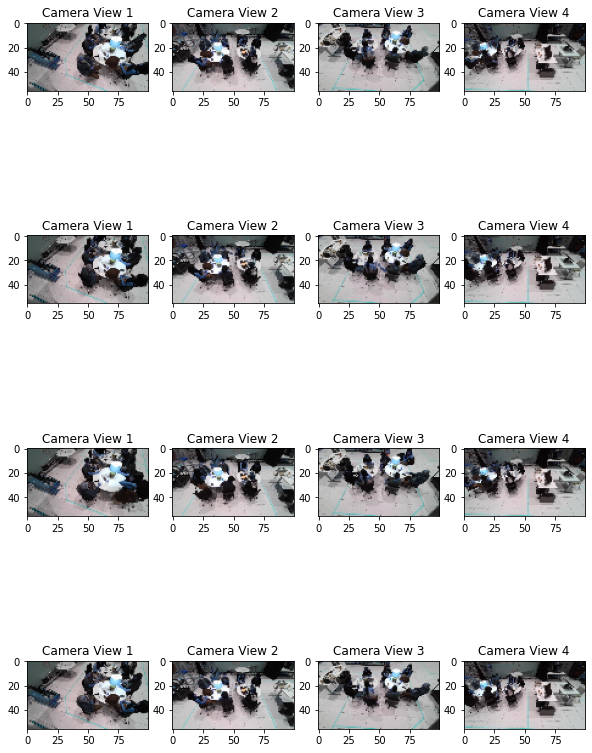

In [ ]:

_, ax = plt.subplots(4, 4, figsize=(10, 15))
for i, samples in enumerate(zip(train_angles_3.take(4), train_angles_1.take(4))):
    cam1 = (((samples[0][0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam2 = (((samples[0][0][1] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam3 = (((samples[0][0][2] * 127.5) + 127.5).numpy()).astype(np.uint8)
    cam4 = (((samples[1][0][0] * 127.5) + 127.5).numpy()).astype(np.uint8)
    #ax[i, 0].imshow(samples[0][0])
    #ax[i, 1].imshow(samples[1][0])
    ax[i, 0].imshow(cam1)
    ax[i, 1].imshow(cam2)
    ax[i, 2].imshow(cam3)
    ax[i, 3].imshow(cam4)
    ax[i, 0].set_title("Camera View 1")
    ax[i, 1].set_title("Camera View 2")
    ax[i, 2].set_title("Camera View 3")
    ax[i, 3].set_title("Camera View 4")
plt.show()


## Building blocks used in the CycleGAN generators and discriminators

In [ ]:

class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1, 1), **kwargs):
        self.padding = tuple(padding)
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        '''
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        '''
        #return tf.pad(input_tensor, padding_tensor, mode="REFLECT")
        return tf.keras.layers.ZeroPadding3D(padding=self.padding)(input_tensor)


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3, 3),
    strides=(1, 1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv3D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv3D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3, 3),
    strides=(2, 2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv3D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3, 3),
    strides=(2, 2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv3DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


## Build the generators


In [ ]:

def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=2, # orig 9
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
    input_img_size=None,
    tag=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")

    noise_input = layers.Input(shape=(512,), name=name + "_noise_input")
    noise = layers.Dense(input_img_size[0]*input_img_size[1]*input_img_size[2]*input_img_size[3])(noise_input)
    noise = layers.Reshape(input_img_size)(noise)
    merge = layers.Concatenate()([img_input,noise])
    x = ReflectionPadding2D(padding=(3, 3, 3))(merge)
   
    x = layers.Conv3D(filters, (7, 7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("relu"))

    # Residual blocks
    
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))
    
    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))
    if tag=='g' or tag=='G':
      #out = 1*112*200*3 # compute dense layer output for G
      out = 1*56*100*3
      #shape = [1,112,200,3]
      shape = [1,56,100,3]
    elif tag=='f' or tag=='F':
      #out = 3*112*200*3 # compute dense layer output for F 
      out = 3*56*100*3
      #shape = [3,112,200,3]
      shape = [3,56,100,3]
    # Final block
    x = ReflectionPadding2D(padding=(3, 3, 3))(x)
    x = layers.Conv3D(3, (7, 7, 7), padding="valid")(x)
    #x = layers.Flatten()(x)
    x = layers.GlobalAveragePooling3D()(x)
    x = layers.Dense(out)(x)
    x = layers.Activation("tanh")(x)
    x = layers.Reshape(shape)(x)

    model = keras.models.Model(inputs=[img_input,noise_input], outputs=x, name=name)
    return model


## Build the discriminators


In [ ]:

def get_discriminator(
    filters=64, 
    kernel_initializer=kernel_init, 
    num_downsampling=3, 
    name=None,
    input_img_size=None,
    cond_input_size=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    cond_input = layers.Input(shape=cond_input_size, name="conditioned_input")
    #cond = layers.Flatten()(cond_input)
    cond = layers.GlobalAveragePooling3D()(cond_input)
    cond = layers.Dense(input_img_size[0]*input_img_size[1]*input_img_size[2]*input_img_size[3])(cond)
    cond = layers.Reshape(input_img_size)(cond)
    merge = layers.Concatenate()([img_input,cond])
    x = layers.Conv3D(
        filters,
        (4, 4, 4),
        strides=(2, 2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(merge)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4, 4),
                strides=(2, 2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4, 4),
                strides=(1, 1, 1),
            )

    x = layers.Conv3D(
        1, (4, 4, 4), strides=(1, 1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    x = layers.Flatten()(x)
    x = layers.Dense(1, activation='sigmoid')(x)
    #model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    model = keras.models.Model(inputs=[img_input,cond_input], outputs=x, name=name)
    return model

In [ ]:
# Get the generators
'''
gen_G = get_resnet_generator(name="generator_G", input_img_size=(3, 112, 200, 3), tag='G')
gen_F = get_resnet_generator(name="generator_F", input_img_size=(1,112, 200, 3), tag='F')
'''
gen_X = get_resnet_generator(name="generator_X", input_img_size=(3, 56, 100, 3), tag='G')
gen_Y = get_resnet_generator(name="generator_Y", input_img_size=(3, 56, 100, 3), tag='G')
gen_Z = get_resnet_generator(name="generator_Z", input_img_size=(3, 56, 100, 3), tag='G')
gen_W = get_resnet_generator(name="generator_W", input_img_size=(3, 56, 100, 3), tag='G')
# Get the discriminators
'''
disc_X = get_discriminator(name="discriminator_X", input_img_size=(3, 112, 200, 3))
disc_Y = get_discriminator(name="discriminator_Y", input_img_size=(1, 112, 200, 3))
'''
disc_X = get_discriminator(name="discriminator_X", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))
disc_Y = get_discriminator(name="discriminator_Y", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))
disc_Z = get_discriminator(name="discriminator_Z", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))
disc_W = get_discriminator(name="discriminator_W", input_img_size=(1, 56, 100, 3), cond_input_size=(3, 56, 100, 3))
disc_set = get_discriminator(name="discriminator_set", input_img_size=(4, 56, 100, 3), cond_input_size=(4, 56, 100, 3))

In [ ]:
from keras.utils.vis_utils import plot_model

In [ ]:
gen_X.summary()

Model: "generator_X"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 generator_X_noise_input (Input  [(None, 512)]       0           []                               
 Layer)                                                                                           
                                                                                                  
 dense (Dense)                  (None, 50400)        25855200    ['generator_X_noise_input[0][0]']
                                                                                                  
 generator_X_img_input (InputLa  [(None, 3, 56, 100,  0          []                               
 yer)                            3)]                                                              
                                                                                        

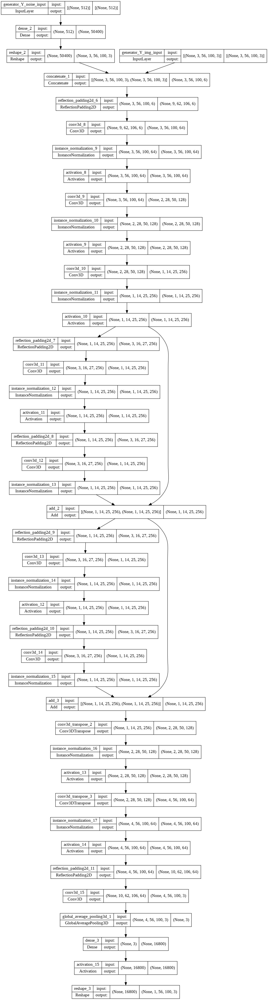

In [ ]:
plot_model(gen_Y, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
disc_X.summary()

Model: "discriminator_X"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 conditioned_input (InputLayer)  [(None, 3, 56, 100,  0          []                               
                                 3)]                                                              
                                                                                                  
 global_average_pooling3d_4 (Gl  (None, 3)           0           ['conditioned_input[0][0]']      
 obalAveragePooling3D)                                                                            
                                                                                                  
 dense_8 (Dense)                (None, 16800)        67200       ['global_average_pooling3d_4[0][0
                                                                 ]']                

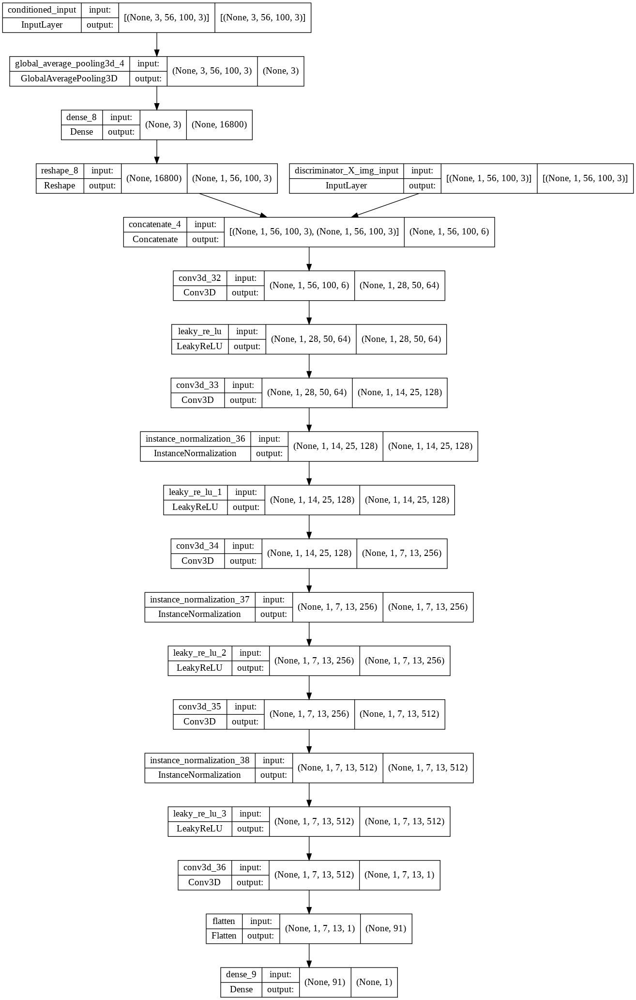

In [ ]:
plot_model(disc_X, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

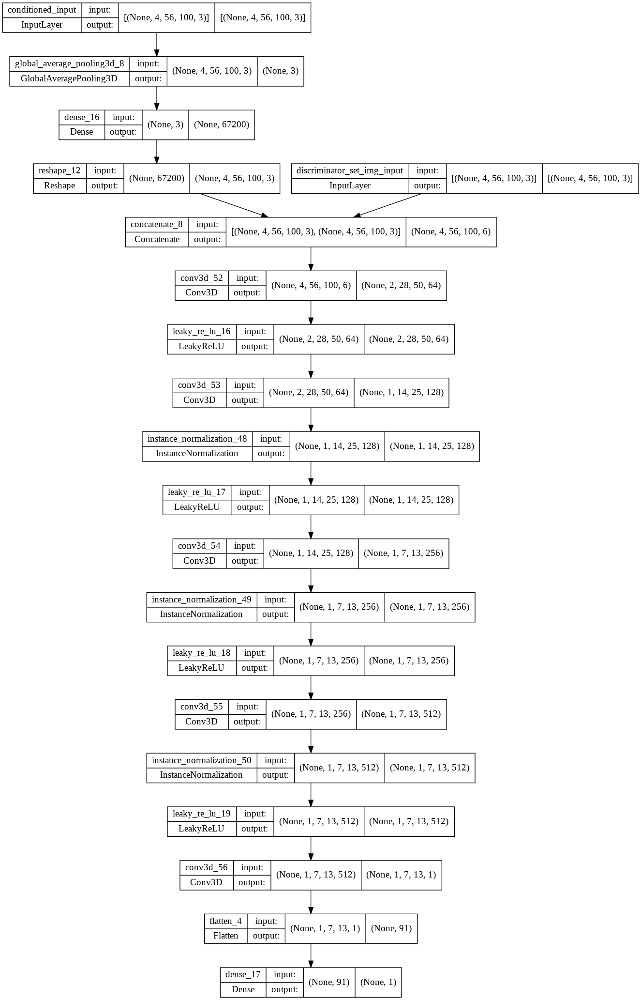

In [ ]:
plot_model(disc_set, to_file='discriminator_plot.png', show_shapes=True, show_layer_names=True)

## Build the CycleGAN model

We will override the `train_step()` method of the `Model` class
for training via `fit()`.

In [ ]:

class CycleGan(keras.Model):
    def __init__(
        self,
        generator_X,
        generator_Y,
        generator_Z,
        generator_W,
        discriminator_X,
        discriminator_Y,
        discriminator_Z,
        discriminator_W,
        discriminator_set,
        lambda_cycle=10.0,
        lambda_identity=0.5,
    ):
        super(CycleGan, self).__init__()
        self.gen_X = generator_X
        self.gen_Y = generator_Y
        self.gen_Z = generator_Z
        self.gen_W = generator_W
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.disc_Z = discriminator_Z
        self.disc_W = discriminator_W
        self.disc_set = discriminator_set
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_X_optimizer,
        gen_Y_optimizer,
        gen_Z_optimizer,
        gen_W_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        disc_Z_optimizer,
        disc_W_optimizer,
        disc_set_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super(CycleGan, self).compile()
        self.gen_X_optimizer = gen_X_optimizer
        self.gen_Y_optimizer = gen_Y_optimizer
        self.gen_Z_optimizer = gen_Z_optimizer
        self.gen_W_optimizer = gen_W_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.disc_Z_optimizer = disc_Z_optimizer
        self.disc_W_optimizer = disc_W_optimizer
        self.disc_set_optimizer = disc_set_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        
        real_x, real_z = batch_data
        real_z = real_z[:,0,...]
        real_w,real_x,real_y = real_x[:,0,:,:,:],real_x[:,1,:,:,:],real_x[:,2,:,:,:]
        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    we can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adverserial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
          
            batch_size = tf.shape(real_x)[0]
            #z_noise = tf.random.normal(shape=(batch_size, 3, 56, 100, 3))
            z_noise = tf.random.normal(shape=(batch_size, 512))
            # w,x,y -> z'
            input1 = tf.stack([real_w,real_x,real_y],axis=1)
            #print("input1",input1.shape)
            fake_z = self.gen_Z([input1,z_noise], training=True)
            # x,y,z -> w'
            input2 = tf.stack([real_x,real_y,real_z],axis=1)
            #print("input2",input2.shape)
            fake_w = self.gen_W([input2,z_noise], training=True)
            # y,z,w -> x'
            input3 = tf.stack([real_y,real_z,real_w],axis=1)
            #print("input3",input3.shape)
            fake_x = self.gen_X([input3,z_noise], training=True)
            # z,w,x -> y'
            input4 = tf.stack([real_z,real_w,real_x],axis=1)
            #print("input4",input4.shape)
            fake_y = self.gen_Y([input4,z_noise], training=True)
            
            # w',x',y' -> z''
            input11 = tf.squeeze(tf.stack([fake_w,fake_x,fake_y],axis=1), axis=2)
            #print("input11",input11.shape)
            fake_zz = self.gen_Z([input11,z_noise], training=True)
            # x',y',z' -> w''
            input22 = tf.squeeze(tf.stack([fake_x,fake_y,fake_z],axis=1), axis=2)
            #print("input22",input22.shape)
            fake_ww = self.gen_W([input22,z_noise], training=True)
            # y',z',w' -> x''
            input33 = tf.squeeze(tf.stack([fake_y,fake_z,fake_w],axis=1), axis=2)
            #print("input33",input33.shape)
            fake_xx = self.gen_X([input33,z_noise], training=True)
            # z',w',x' -> y''
            input44 = tf.squeeze(tf.stack([fake_z,fake_w,fake_x],axis=1), axis=2)
            #print("input44",input44.shape)
            fake_yy = self.gen_Y([input44,z_noise], training=True)
            # Identity mapping
            #same_x = self.gen_F(real_x, training=True)
            #same_y = self.gen_G(real_y, training=True)

            
            # Discriminator output
            real_set = tf.stack([real_w,real_x,real_y,real_z],axis=1)
            fake_set = tf.squeeze(tf.stack([fake_w,fake_x,fake_y,fake_z],axis=1))
            '''
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)
            '''
            #disc_real_x = self.disc_X([tf.expand_dims(real_x, axis=1), input3], training=True)
            #disc_fake_x = self.disc_X([fake_x, input3], training=True)

            #disc_real_y = self.disc_Y([tf.expand_dims(real_y, axis=1), input4], training=True)
            #disc_fake_y = self.disc_Y([fake_y, input4], training=True)

            #disc_real_z = self.disc_Z([tf.expand_dims(real_z, axis=1), input1], training=True)
            #disc_fake_z = self.disc_Z([fake_z, input1], training=True)

            #disc_real_w = self.disc_W([tf.expand_dims(real_w, axis=1), input2], training=True)
            #disc_fake_w = self.disc_W([fake_w, input2], training=True)
            
            disc_real_set = self.disc_set([real_set,real_set], training=True)
            disc_fake_set = self.disc_set([fake_set,fake_set], training=True)
            
            # Generator adverserial loss
            '''
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)
            '''
            #gen_X_loss = self.generator_loss_fn(disc_fake_x)
            #gen_Y_loss = self.generator_loss_fn(disc_fake_y)
            #gen_Z_loss = self.generator_loss_fn(disc_fake_z)
            #gen_W_loss = self.generator_loss_fn(disc_fake_w)
            gen_set_loss = self.generator_loss_fn(disc_fake_set)
            # Generator cycle loss
            '''
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle
            '''
            cycle_loss_X = self.cycle_loss_fn(real_x, fake_xx) * self.lambda_cycle
            cycle_loss_Y = self.cycle_loss_fn(real_y, fake_yy) * self.lambda_cycle
            cycle_loss_Z = self.cycle_loss_fn(real_z, fake_zz) * self.lambda_cycle
            cycle_loss_W = self.cycle_loss_fn(real_w, fake_ww) * self.lambda_cycle
            # Generator identity loss
            '''
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )
            '''
            # Total generator loss
            '''
            total_loss_G = gen_G_loss + cycle_loss_G# + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F# + id_loss_F
            '''
            #total_loss_X = gen_X_loss + cycle_loss_X# + id_loss_G
            #total_loss_Y = gen_Y_loss + cycle_loss_Y# + id_loss_F
            #total_loss_Z = gen_Z_loss + cycle_loss_Z# + id_loss_G
            #total_loss_W = gen_W_loss + cycle_loss_W# + id_loss_F
            cycle_loss = cycle_loss_X + cycle_loss_Y + cycle_loss_Z + cycle_loss_W
            total_loss_set = gen_set_loss + cycle_loss
            # Discriminator loss
            '''
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)
            '''
            #disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            #disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)
            #disc_Z_loss = self.discriminator_loss_fn(disc_real_z, disc_fake_z)
            #disc_W_loss = self.discriminator_loss_fn(disc_real_w, disc_fake_w)
            disc_set_loss = self.discriminator_loss_fn(disc_real_set, disc_fake_set)
        # Get the gradients for the generators
        '''
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)
        '''
        #grads_X = tape.gradient(total_loss_X, self.gen_X.trainable_variables)
        #grads_Y = tape.gradient(total_loss_Y, self.gen_Y.trainable_variables)
        #grads_Z = tape.gradient(total_loss_Z, self.gen_Z.trainable_variables)
        #grads_W = tape.gradient(total_loss_W, self.gen_W.trainable_variables)
        grads_X = tape.gradient(total_loss_set, self.gen_X.trainable_variables)
        grads_Y = tape.gradient(total_loss_set, self.gen_Y.trainable_variables)
        grads_Z = tape.gradient(total_loss_set, self.gen_Z.trainable_variables)
        grads_W = tape.gradient(total_loss_set, self.gen_W.trainable_variables)
        # Get the gradients for the discriminators
        '''
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)
        '''
        #disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        #disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)
        #disc_Z_grads = tape.gradient(disc_Z_loss, self.disc_Z.trainable_variables)
        #disc_W_grads = tape.gradient(disc_W_loss, self.disc_W.trainable_variables)
        disc_set_grads = tape.gradient(disc_set_loss, self.disc_set.trainable_variables) 
        # Update the weights of the generators
        '''
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )
        '''
        self.gen_X_optimizer.apply_gradients(
            zip(grads_X, self.gen_X.trainable_variables)
        )
        self.gen_Y_optimizer.apply_gradients(
            zip(grads_Y, self.gen_Y.trainable_variables)
        )
        self.gen_Z_optimizer.apply_gradients(
            zip(grads_Z, self.gen_Z.trainable_variables)
        )
        self.gen_W_optimizer.apply_gradients(
            zip(grads_W, self.gen_W.trainable_variables)
        )
        # Update the weights of the discriminators
        '''
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )
        '''
        '''
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )
        self.disc_Z_optimizer.apply_gradients(
            zip(disc_Z_grads, self.disc_Z.trainable_variables)
        )
        
        self.disc_W_optimizer.apply_gradients(
            zip(disc_W_grads, self.disc_W.trainable_variables)
        )
        '''
        self.disc_set_optimizer.apply_gradients(
            zip(disc_set_grads, self.disc_set.trainable_variables)
        )
        '''
        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }
        '''
        '''
        return {
            "X_loss": total_loss_X,
            "Y_loss": total_loss_Y,
            "Z_loss": total_loss_Z,
            "W_loss": total_loss_W,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
            "D_Z_loss": disc_Z_loss,
            "D_W_loss": disc_W_loss,
            "D_set_loss": disc_set_loss
        }
        '''
        return {
            "set_loss": total_loss_set,
            "D_set_loss": disc_set_loss
        }

## Create a callback that periodically saves generated images

In [ ]:
class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
        _, ax = plt.subplots(4, 4, figsize=(10, 15))
        for i, img in enumerate(test_angles_3.take(self.num_img)):
            batch_size = tf.shape(img)[0]
            z_noise = tf.random.normal(shape=(batch_size, 512))
            prediction = self.model.gen_Z([img,z_noise])[0][0].numpy()
            prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
            img1 = (img[0][0] * 127.5 + 127.5).numpy().astype(np.uint8)
            img2 = (img[0][1] * 127.5 + 127.5).numpy().astype(np.uint8)
            img3 = (img[0][2] * 127.5 + 127.5).numpy().astype(np.uint8)
            
            ax[i, 0].imshow(img1)
            ax[i, 1].imshow(img2)
            ax[i, 2].imshow(img3)
            ax[i, 3].imshow(prediction)

            ax[i, 0].set_title("Input image")
            ax[i, 1].set_title("Input image")
            ax[i, 2].set_title("Input image")
            ax[i, 3].set_title("Translated image")
            ax[i, 0].axis("off")
            ax[i, 1].axis("off")
            ax[i, 2].axis("off")
            ax[i, 3].axis("off")

            prediction = keras.preprocessing.image.array_to_img(prediction)
            prediction.save(
                "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_{i}_{epoch}.png".format(i=i, epoch=epoch + 1)
            )
        plt.show()
        plt.close()

## Train the end-to-end model

Epoch 1/50
32/32 [==============================] - ETA: 0s - set_loss: 20.6525 - D_set_loss: 0.0923

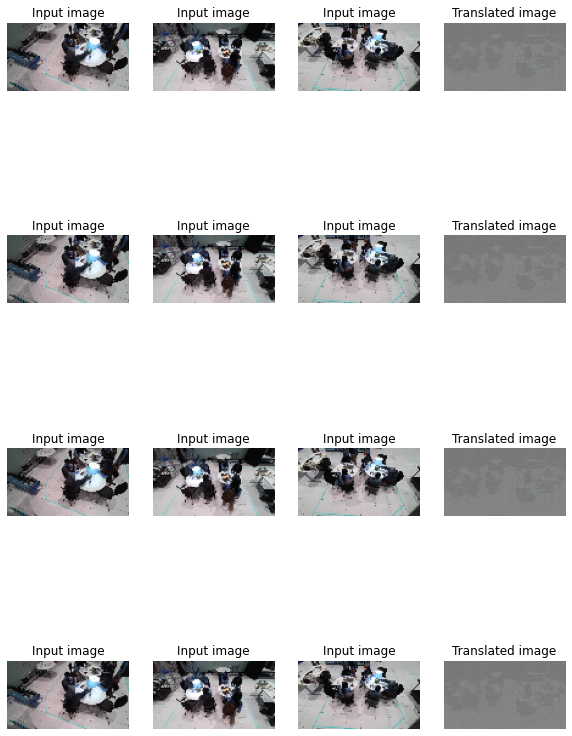

32/32 [==============================] - 171s 3s/step - set_loss: 20.6372 - D_set_loss: 0.0896
Epoch 2/50
32/32 [==============================] - ETA: 0s - set_loss: 15.4963 - D_set_loss: 0.0481

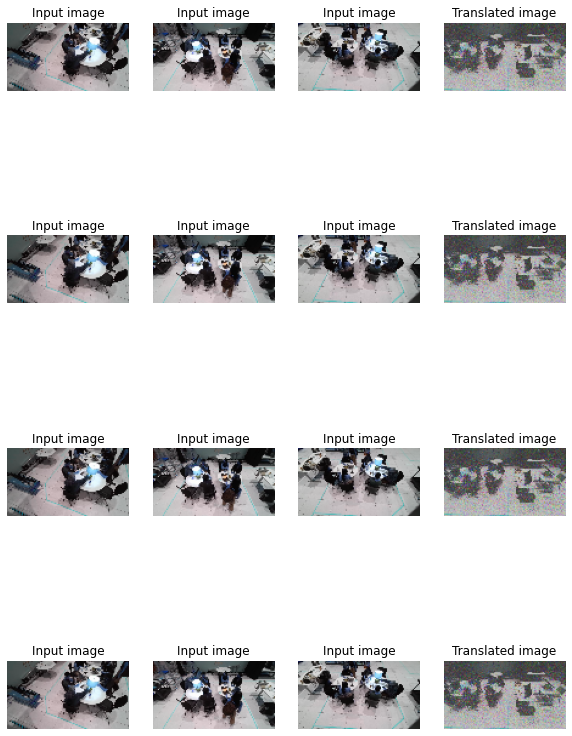

32/32 [==============================] - 78s 2s/step - set_loss: 15.3435 - D_set_loss: 0.0471
Epoch 3/50
32/32 [==============================] - ETA: 0s - set_loss: 7.9851 - D_set_loss: 0.0787

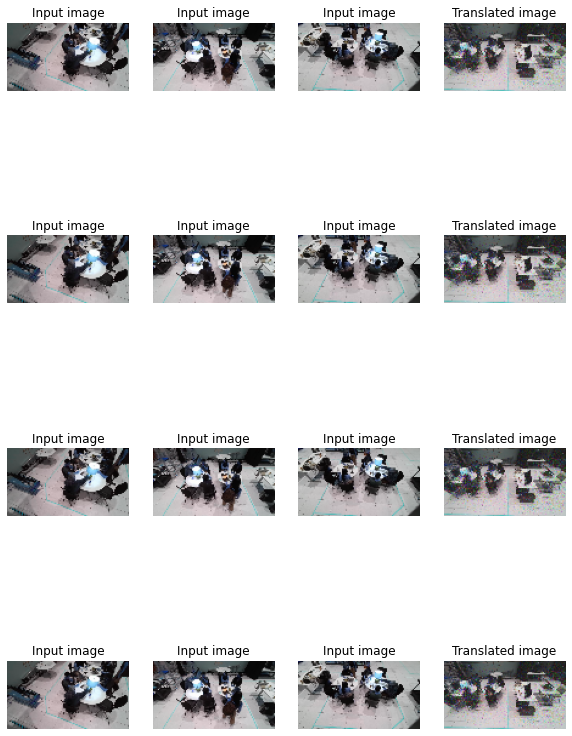

32/32 [==============================] - 77s 2s/step - set_loss: 7.9424 - D_set_loss: 0.0770
Epoch 4/50
32/32 [==============================] - ETA: 0s - set_loss: 5.5779 - D_set_loss: 0.0993

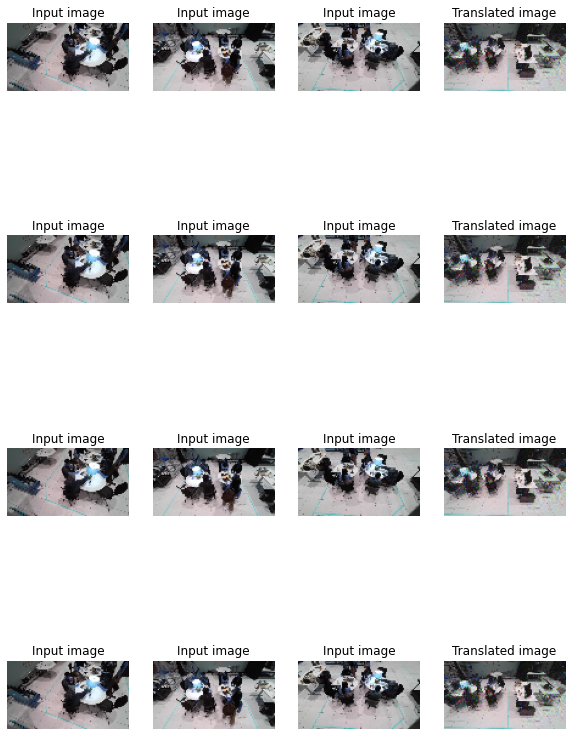

32/32 [==============================] - 77s 2s/step - set_loss: 5.5718 - D_set_loss: 0.0977
Epoch 5/50
32/32 [==============================] - ETA: 0s - set_loss: 4.8066 - D_set_loss: 0.1083

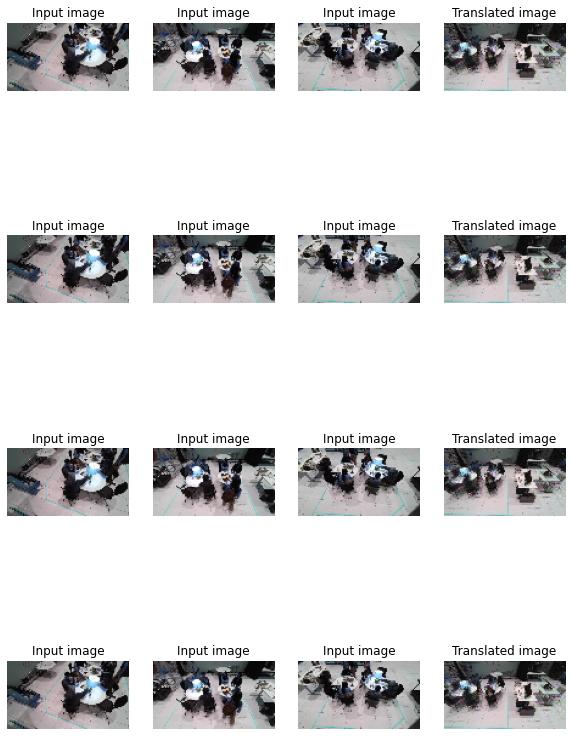

32/32 [==============================] - 77s 2s/step - set_loss: 4.8053 - D_set_loss: 0.1096
Epoch 6/50
32/32 [==============================] - ETA: 0s - set_loss: 4.5833 - D_set_loss: 0.0626

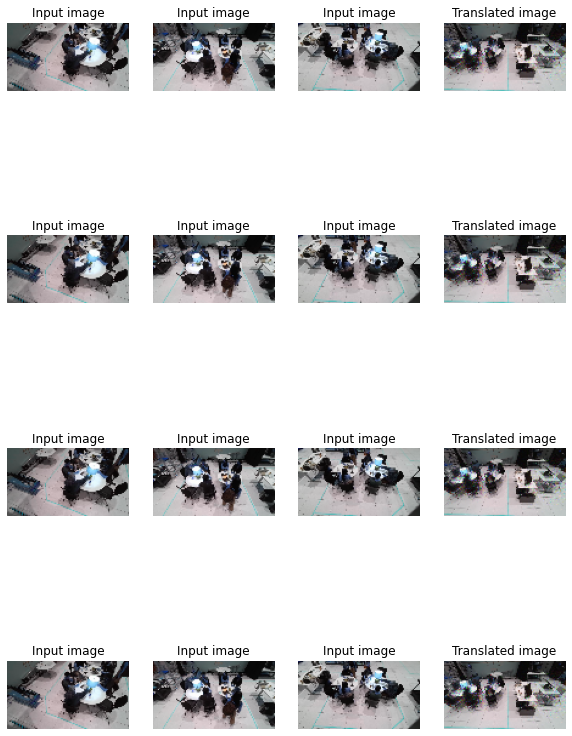

32/32 [==============================] - 77s 2s/step - set_loss: 4.5928 - D_set_loss: 0.0611
Epoch 7/50
32/32 [==============================] - ETA: 0s - set_loss: 4.4244 - D_set_loss: 0.0673

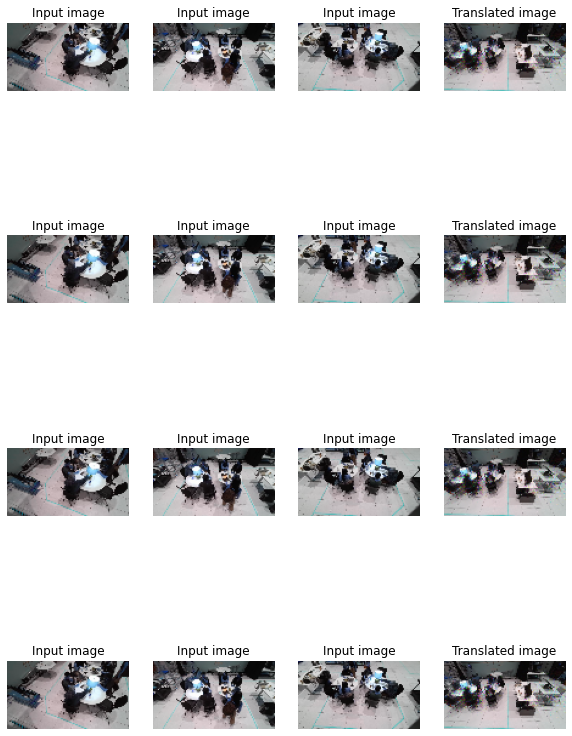

32/32 [==============================] - 77s 2s/step - set_loss: 4.4175 - D_set_loss: 0.0665
Epoch 8/50
32/32 [==============================] - ETA: 0s - set_loss: 4.3707 - D_set_loss: 0.0747

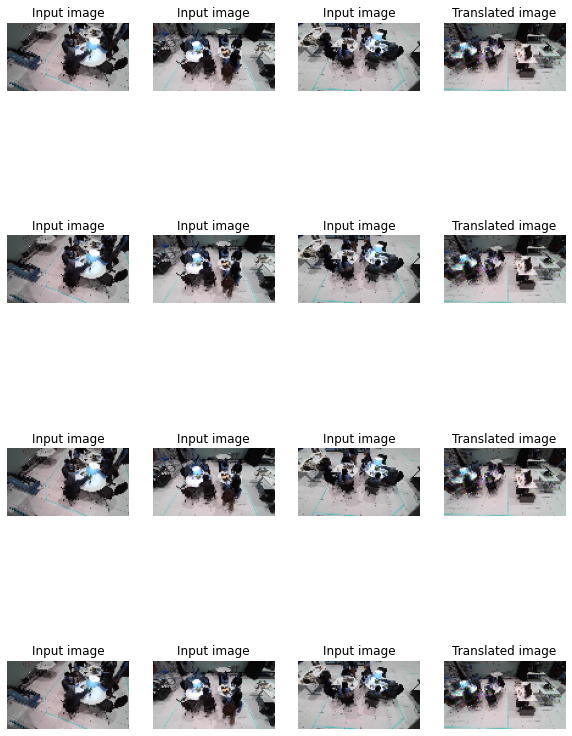

32/32 [==============================] - 77s 2s/step - set_loss: 4.3857 - D_set_loss: 0.0759
Epoch 9/50
32/32 [==============================] - ETA: 0s - set_loss: 4.3282 - D_set_loss: 0.0949

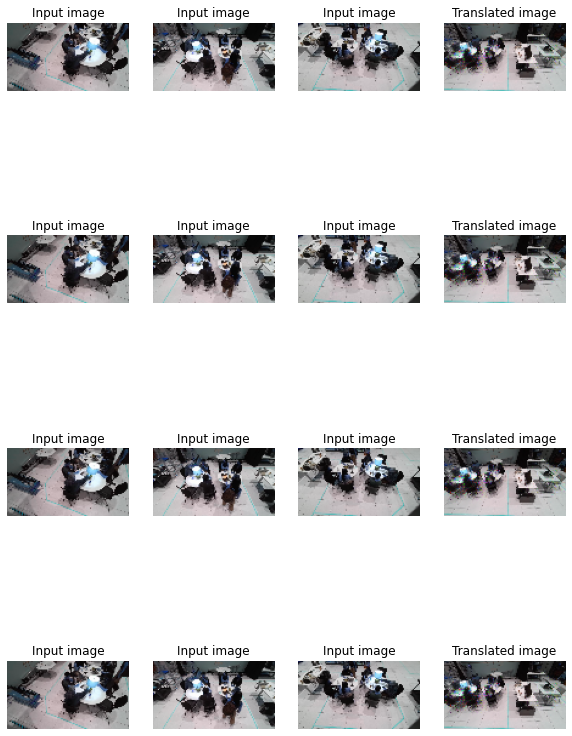

32/32 [==============================] - 77s 2s/step - set_loss: 4.3477 - D_set_loss: 0.0932
Epoch 10/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2341 - D_set_loss: 0.0855

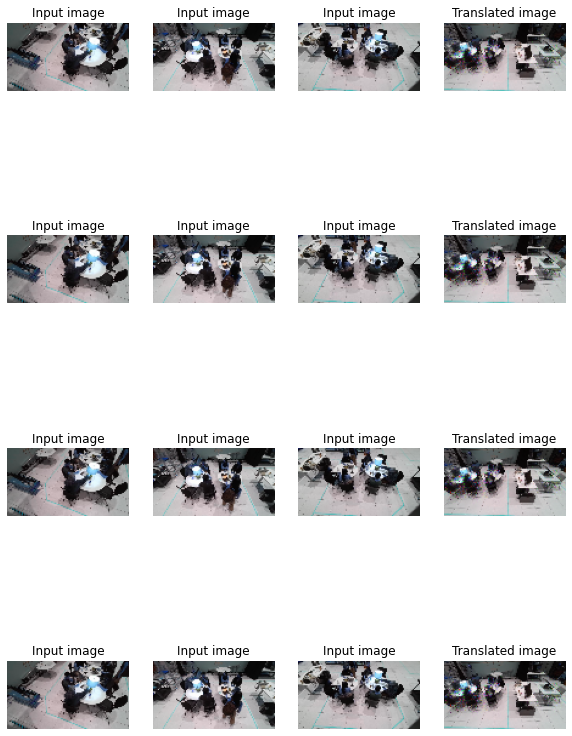

32/32 [==============================] - 78s 2s/step - set_loss: 4.2405 - D_set_loss: 0.0867
Epoch 11/50
32/32 [==============================] - ETA: 0s - set_loss: 4.3355 - D_set_loss: 0.0838

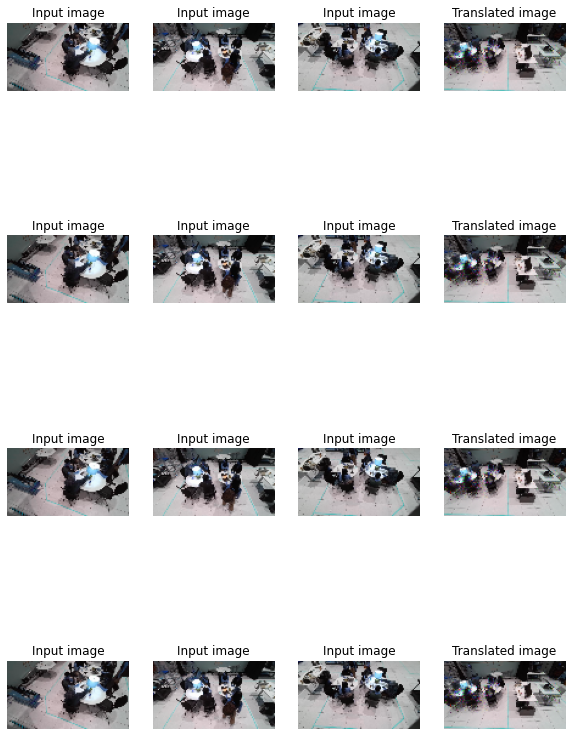

32/32 [==============================] - 77s 2s/step - set_loss: 4.3318 - D_set_loss: 0.0836
Epoch 12/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2055 - D_set_loss: 0.0702

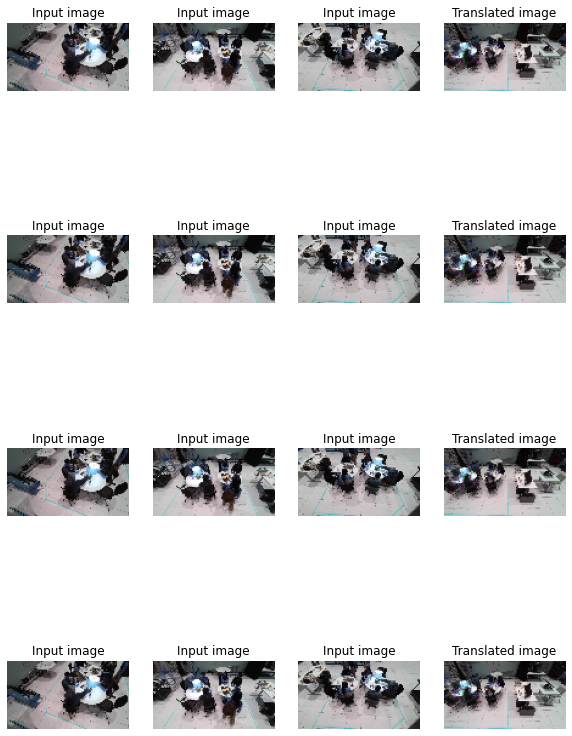

32/32 [==============================] - 78s 2s/step - set_loss: 4.2242 - D_set_loss: 0.0682
Epoch 13/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1184 - D_set_loss: 0.0603

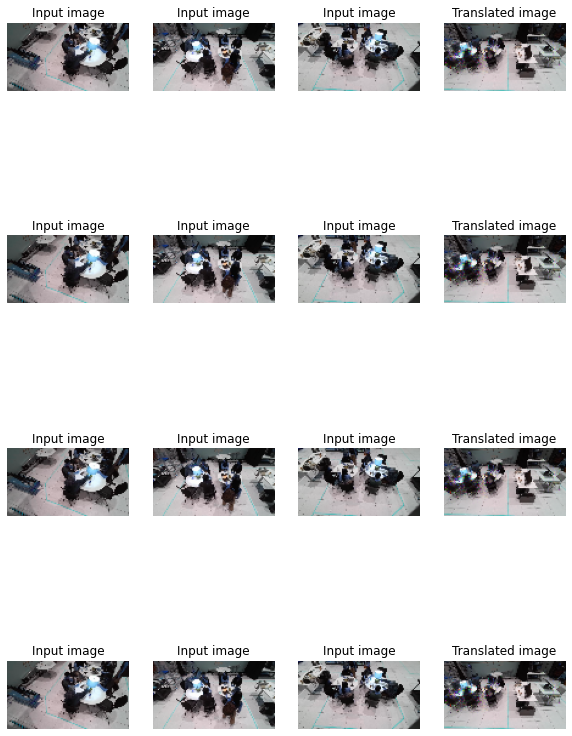

32/32 [==============================] - 77s 2s/step - set_loss: 4.1191 - D_set_loss: 0.0590
Epoch 14/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1339 - D_set_loss: 0.0680

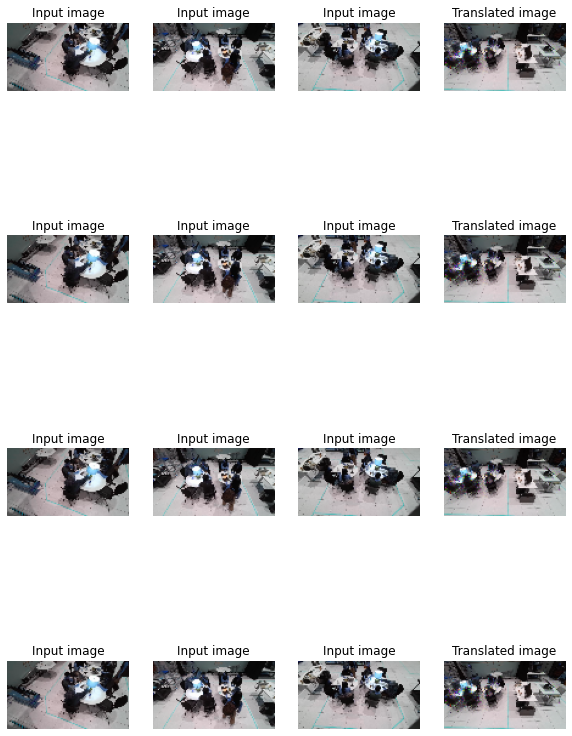

32/32 [==============================] - 77s 2s/step - set_loss: 4.1431 - D_set_loss: 0.0664
Epoch 15/50
32/32 [==============================] - ETA: 0s - set_loss: 4.0945 - D_set_loss: 0.0587

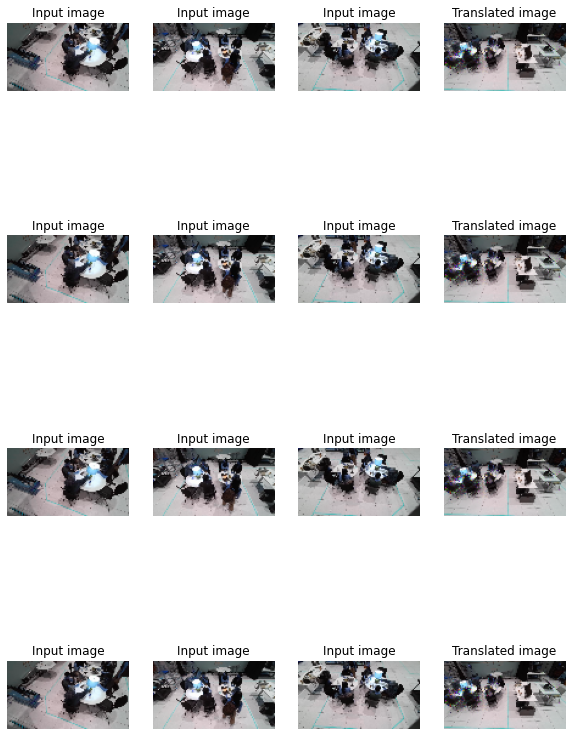

32/32 [==============================] - 77s 2s/step - set_loss: 4.0867 - D_set_loss: 0.0573
Epoch 16/50
32/32 [==============================] - ETA: 0s - set_loss: 4.0864 - D_set_loss: 0.0540

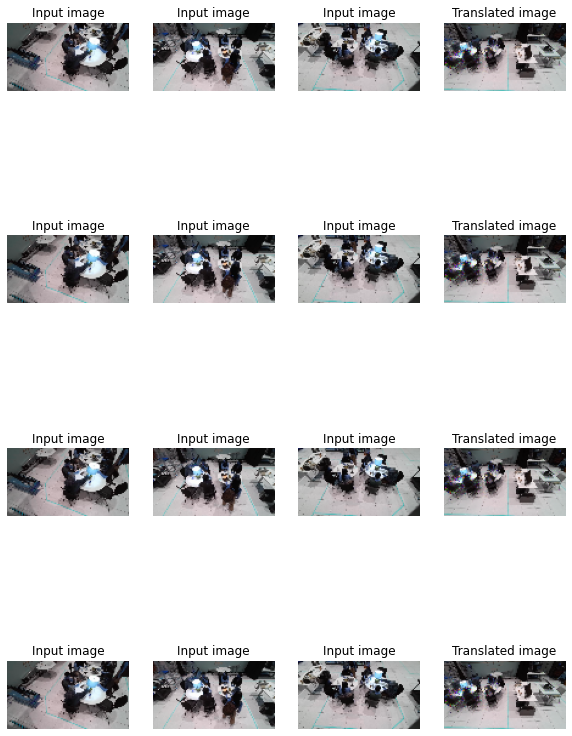

32/32 [==============================] - 78s 2s/step - set_loss: 4.0896 - D_set_loss: 0.0530
Epoch 17/50
32/32 [==============================] - ETA: 0s - set_loss: 4.0939 - D_set_loss: 0.0455

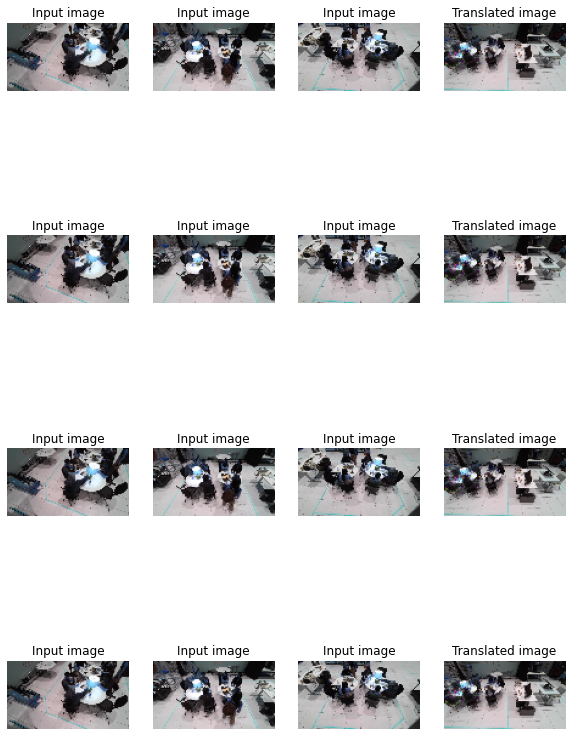

32/32 [==============================] - 77s 2s/step - set_loss: 4.0939 - D_set_loss: 0.0443
Epoch 18/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1742 - D_set_loss: 0.0342

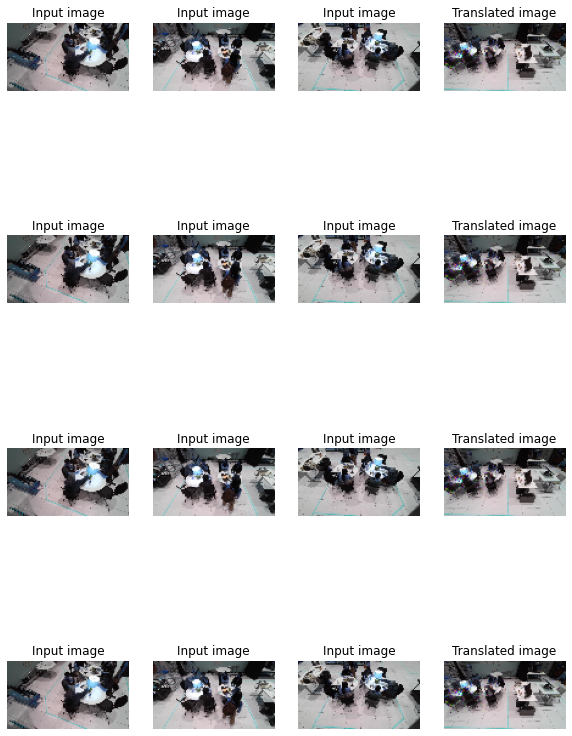

32/32 [==============================] - 77s 2s/step - set_loss: 4.2032 - D_set_loss: 0.0340
Epoch 19/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2478 - D_set_loss: 0.0552

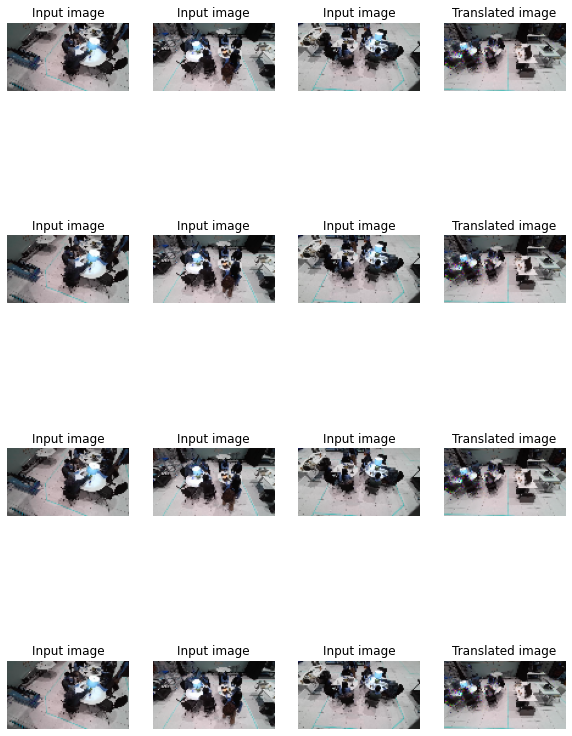

32/32 [==============================] - 77s 2s/step - set_loss: 4.2331 - D_set_loss: 0.0562
Epoch 20/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1264 - D_set_loss: 0.0510

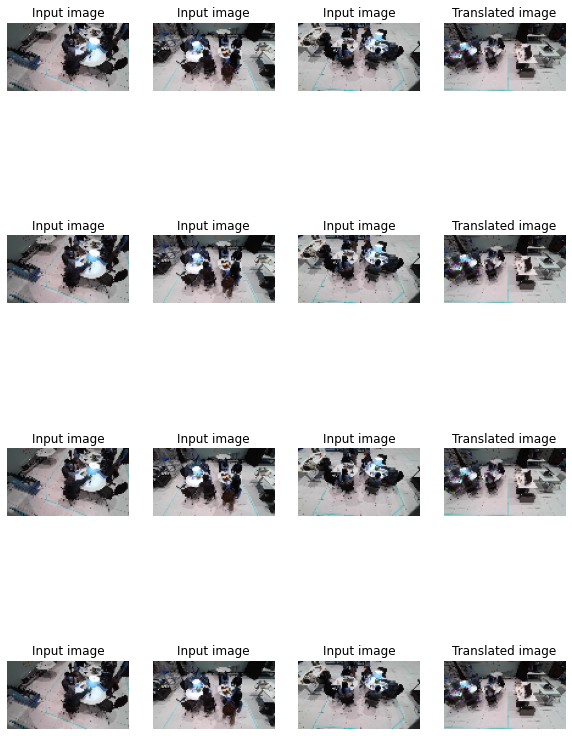

32/32 [==============================] - 77s 2s/step - set_loss: 4.1075 - D_set_loss: 0.0502
Epoch 21/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2133 - D_set_loss: 0.0302

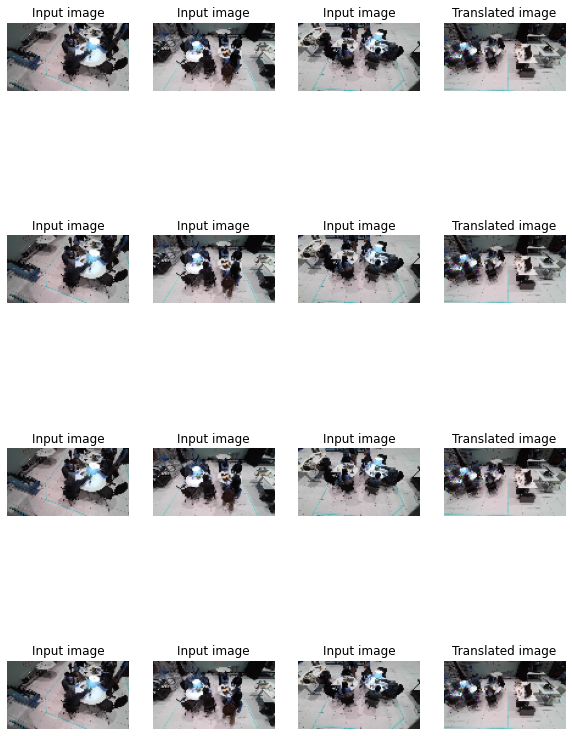

32/32 [==============================] - 77s 2s/step - set_loss: 4.2305 - D_set_loss: 0.0293
Epoch 22/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1960 - D_set_loss: 0.0231

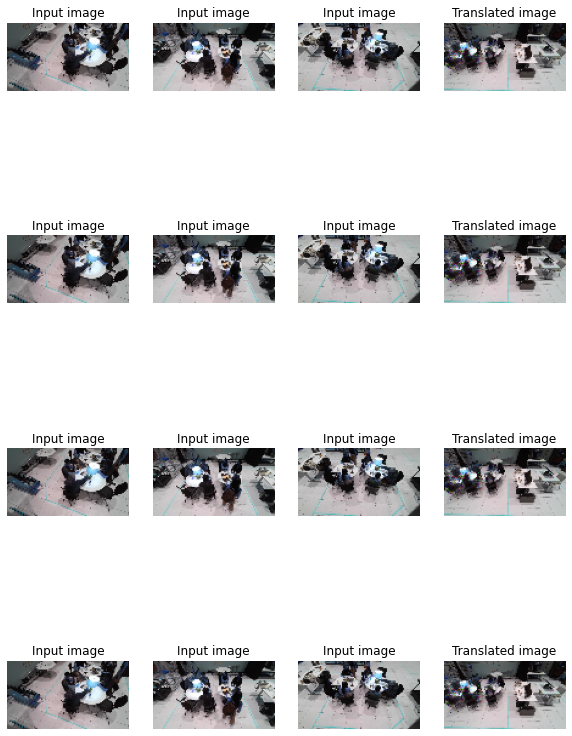

32/32 [==============================] - 78s 2s/step - set_loss: 4.1845 - D_set_loss: 0.0256
Epoch 23/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1949 - D_set_loss: 0.0544

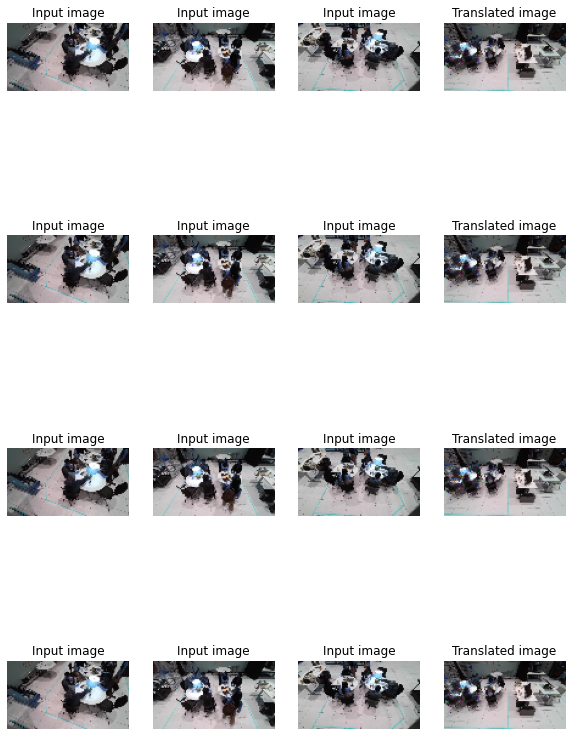

32/32 [==============================] - 77s 2s/step - set_loss: 4.1984 - D_set_loss: 0.0530
Epoch 24/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1865 - D_set_loss: 0.0432

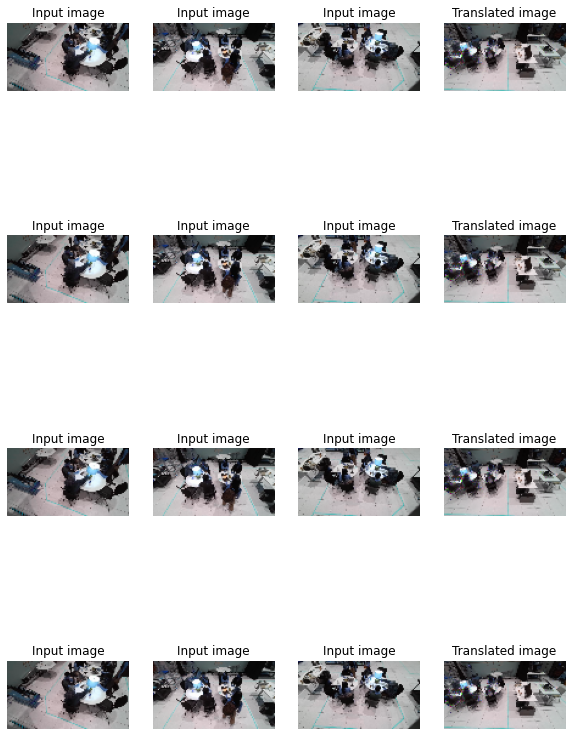

32/32 [==============================] - 77s 2s/step - set_loss: 4.1932 - D_set_loss: 0.0420
Epoch 25/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2151 - D_set_loss: 0.0215

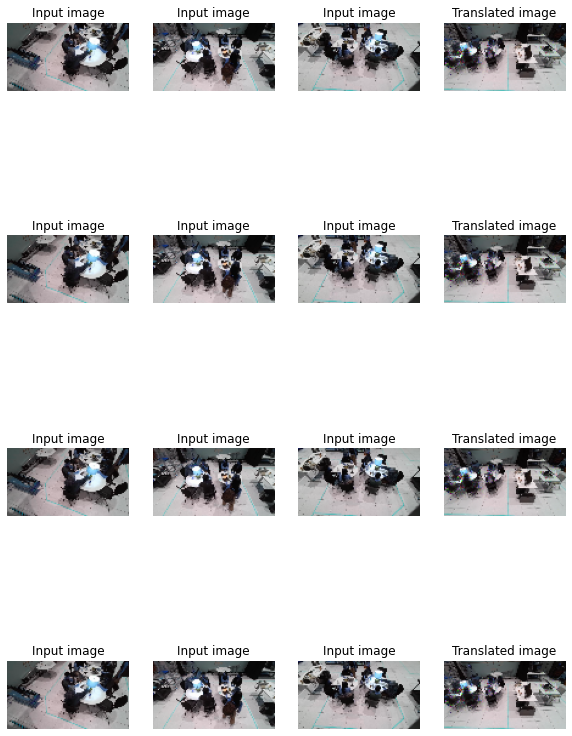

32/32 [==============================] - 78s 2s/step - set_loss: 4.2316 - D_set_loss: 0.0220
Epoch 26/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2811 - D_set_loss: 0.0322

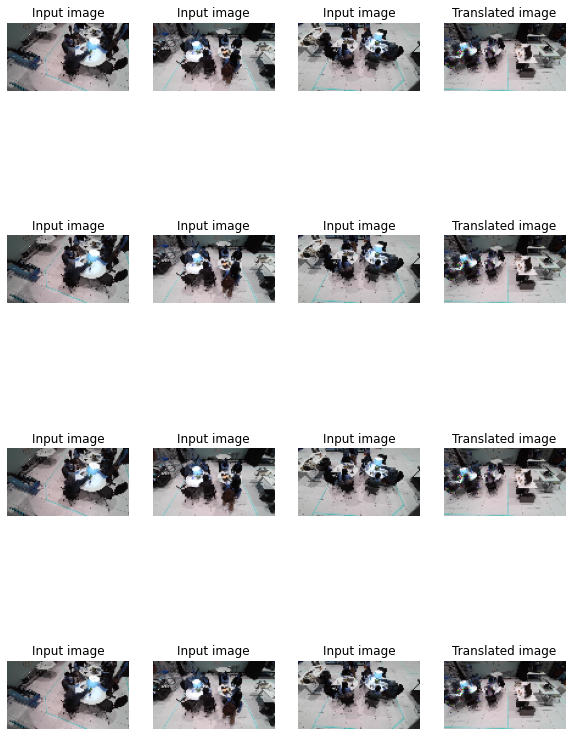

32/32 [==============================] - 77s 2s/step - set_loss: 4.2923 - D_set_loss: 0.0312
Epoch 27/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2040 - D_set_loss: 0.0053

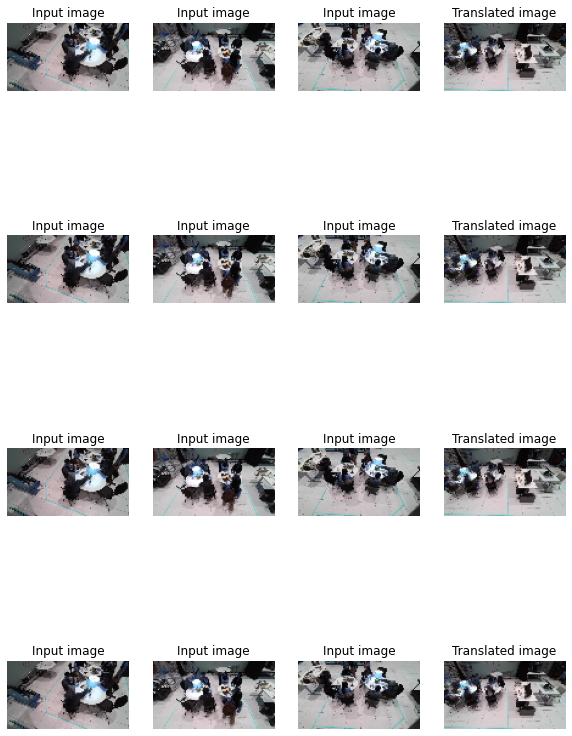

32/32 [==============================] - 77s 2s/step - set_loss: 4.2074 - D_set_loss: 0.0056
Epoch 28/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2061 - D_set_loss: 0.0545

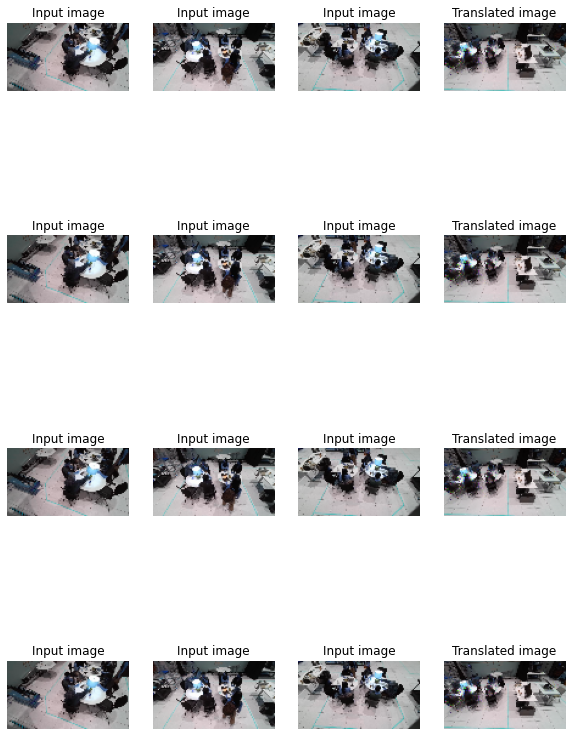

32/32 [==============================] - 77s 2s/step - set_loss: 4.2243 - D_set_loss: 0.0529
Epoch 29/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2431 - D_set_loss: 0.0092

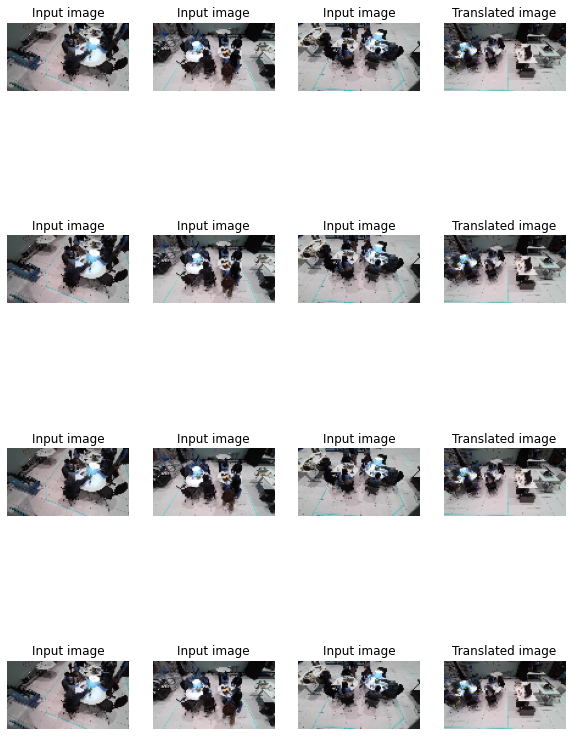

32/32 [==============================] - 77s 2s/step - set_loss: 4.2426 - D_set_loss: 0.0091
Epoch 30/50
32/32 [==============================] - ETA: 0s - set_loss: 4.3901 - D_set_loss: 0.0322

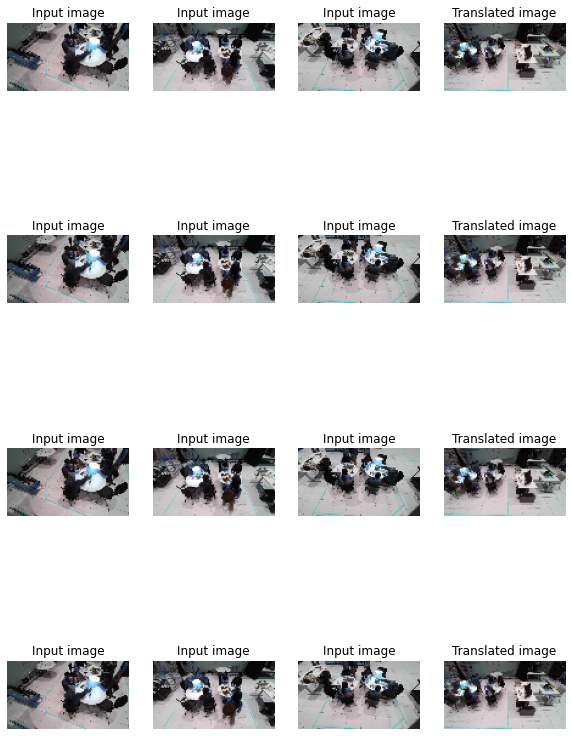

32/32 [==============================] - 77s 2s/step - set_loss: 4.3943 - D_set_loss: 0.0347
Epoch 31/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2632 - D_set_loss: 0.0311

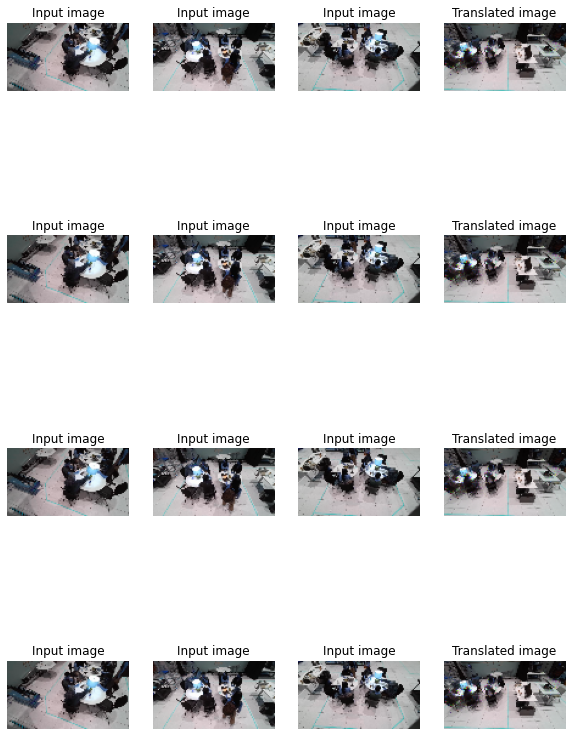

32/32 [==============================] - 78s 2s/step - set_loss: 4.2641 - D_set_loss: 0.0305
Epoch 32/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2700 - D_set_loss: 0.0487

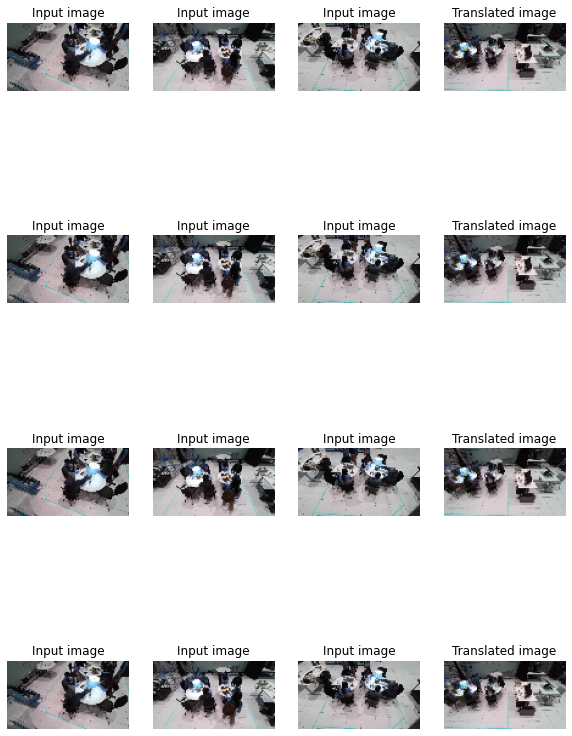

32/32 [==============================] - 77s 2s/step - set_loss: 4.2835 - D_set_loss: 0.0472
Epoch 33/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1994 - D_set_loss: 0.0137

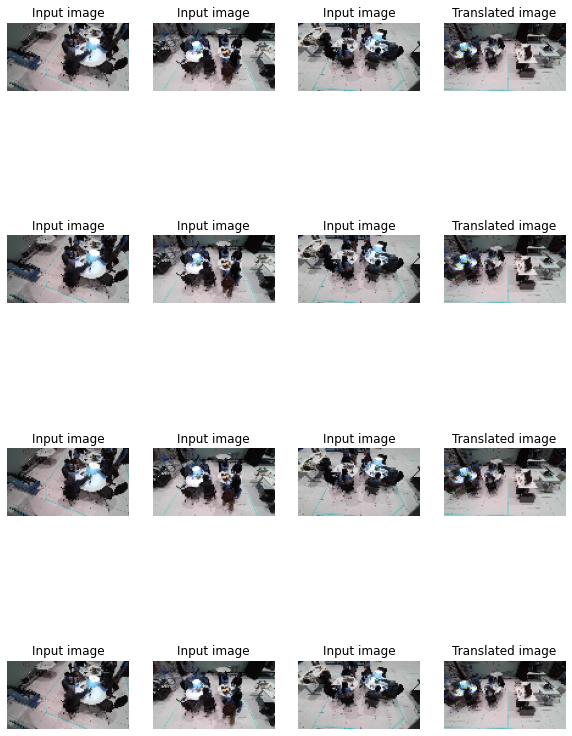

32/32 [==============================] - 78s 2s/step - set_loss: 4.1967 - D_set_loss: 0.0143
Epoch 34/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2937 - D_set_loss: 0.0281

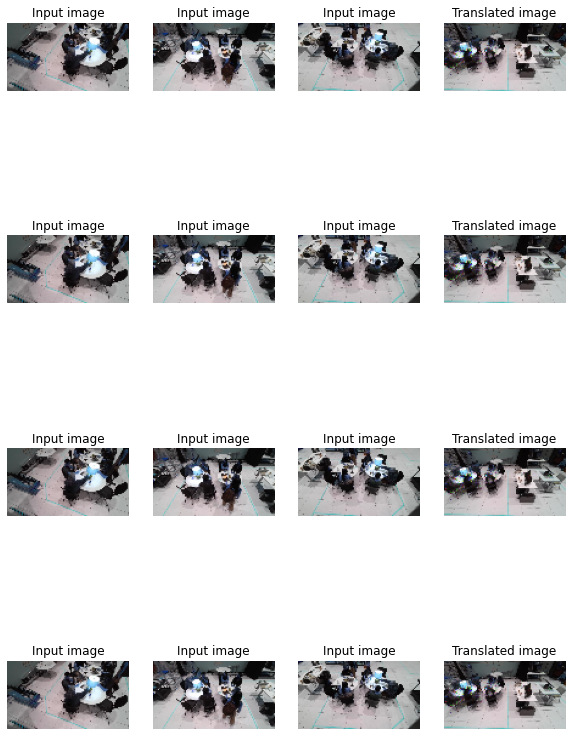

32/32 [==============================] - 77s 2s/step - set_loss: 4.2952 - D_set_loss: 0.0306
Epoch 35/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2883 - D_set_loss: 0.0408

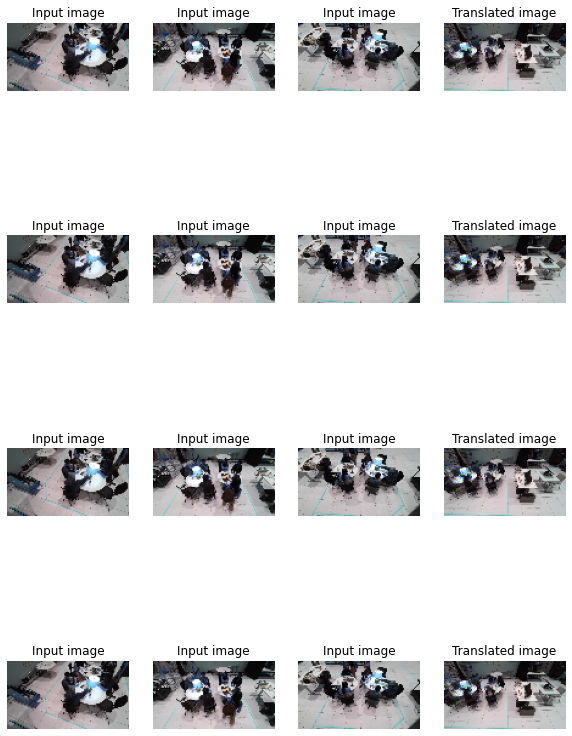

32/32 [==============================] - 77s 2s/step - set_loss: 4.3109 - D_set_loss: 0.0396
Epoch 36/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1370 - D_set_loss: 0.0478

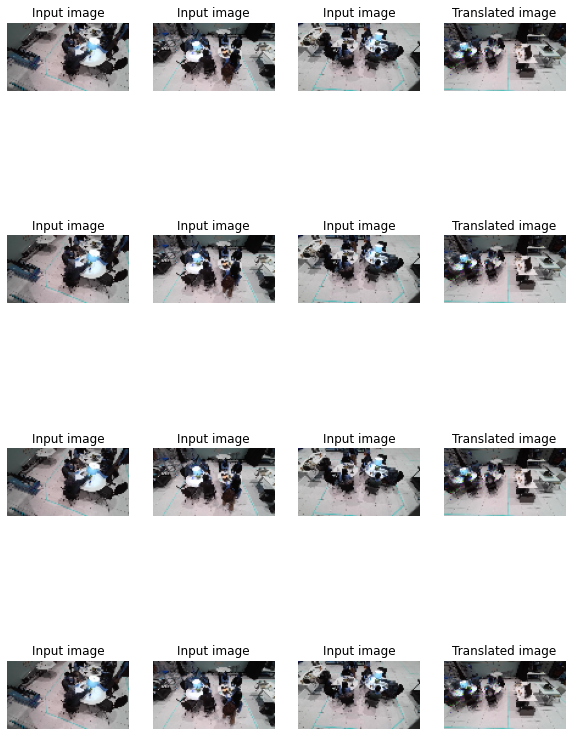

32/32 [==============================] - 77s 2s/step - set_loss: 4.1651 - D_set_loss: 0.0465
Epoch 37/50
32/32 [==============================] - ETA: 0s - set_loss: 4.2352 - D_set_loss: 0.0170

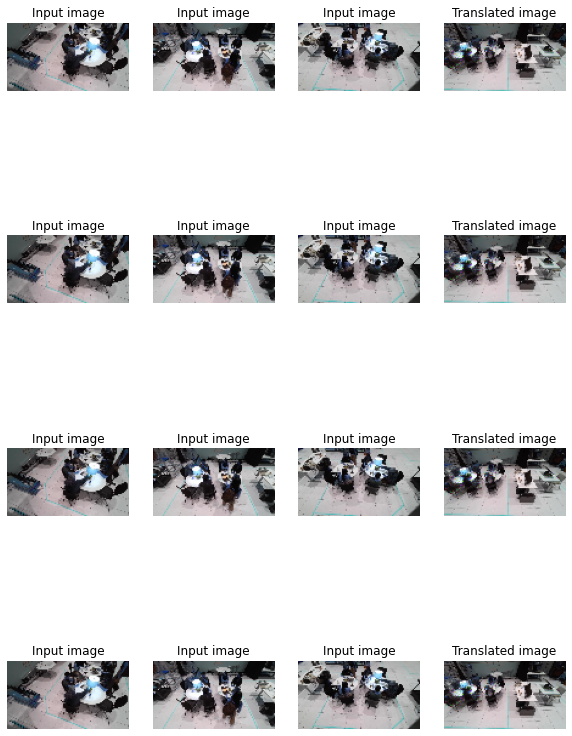

32/32 [==============================] - 77s 2s/step - set_loss: 4.2421 - D_set_loss: 0.0165
Epoch 38/50
32/32 [==============================] - ETA: 0s - set_loss: 4.3060 - D_set_loss: 0.0611

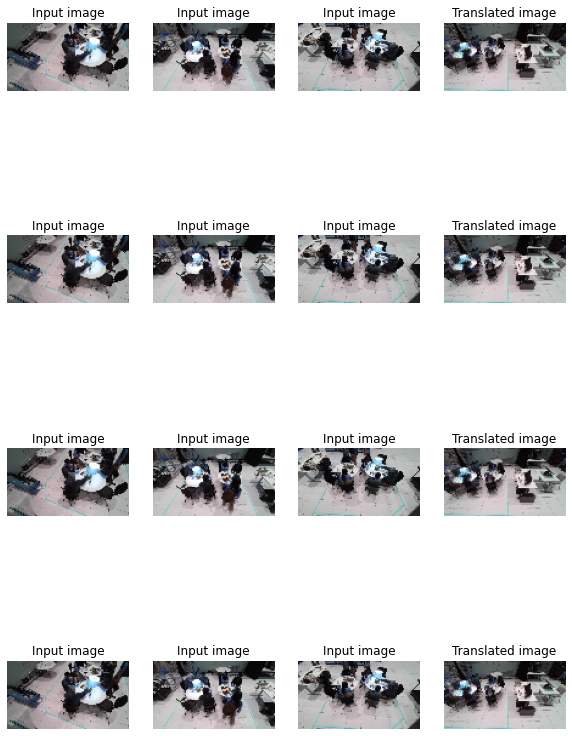

32/32 [==============================] - 77s 2s/step - set_loss: 4.3190 - D_set_loss: 0.0593
Epoch 39/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1343 - D_set_loss: 0.0301

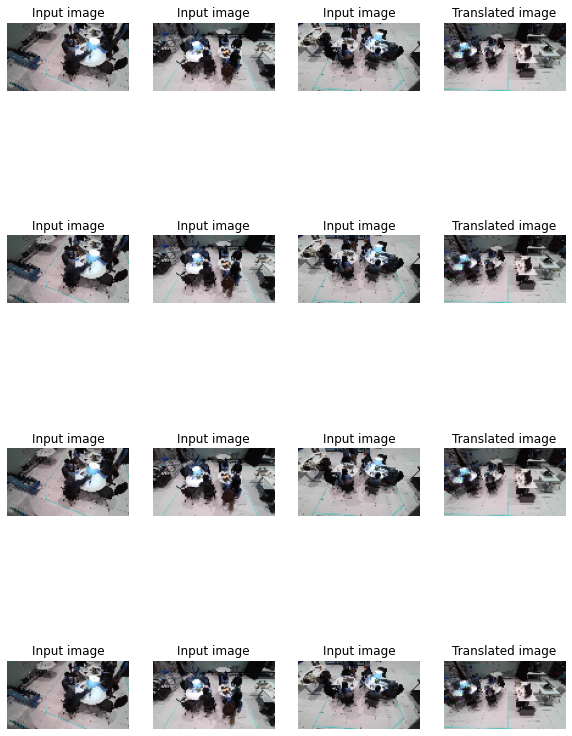

32/32 [==============================] - 77s 2s/step - set_loss: 4.1420 - D_set_loss: 0.0292
Epoch 40/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1422 - D_set_loss: 0.0148

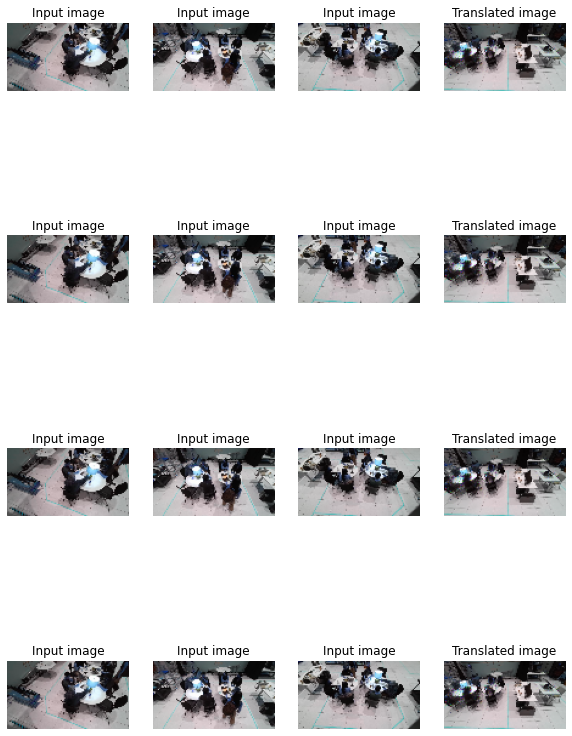

32/32 [==============================] - 77s 2s/step - set_loss: 4.1530 - D_set_loss: 0.0143
Epoch 41/50
32/32 [==============================] - ETA: 0s - set_loss: 4.1101 - D_set_loss: 1.9016e-04

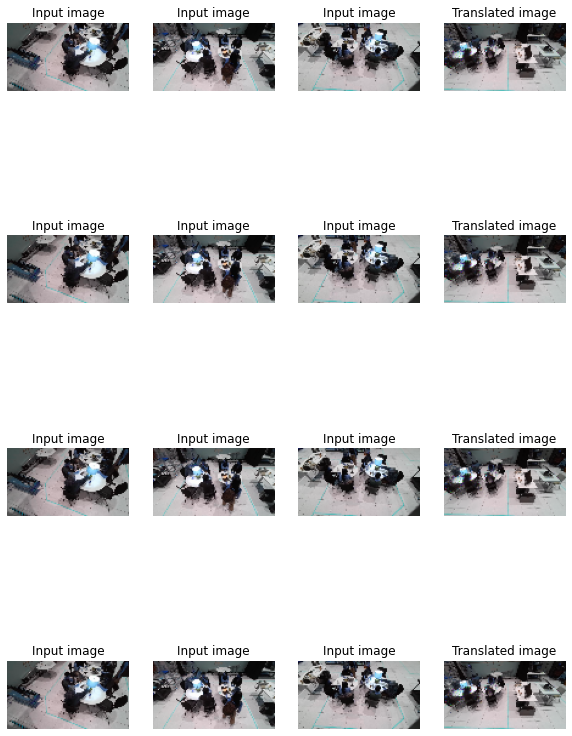

32/32 [==============================] - 78s 2s/step - set_loss: 4.1180 - D_set_loss: 1.8475e-04
Epoch 42/50
32/32 [==============================] - ETA: 0s - set_loss: 4.0474 - D_set_loss: 2.5326e-05

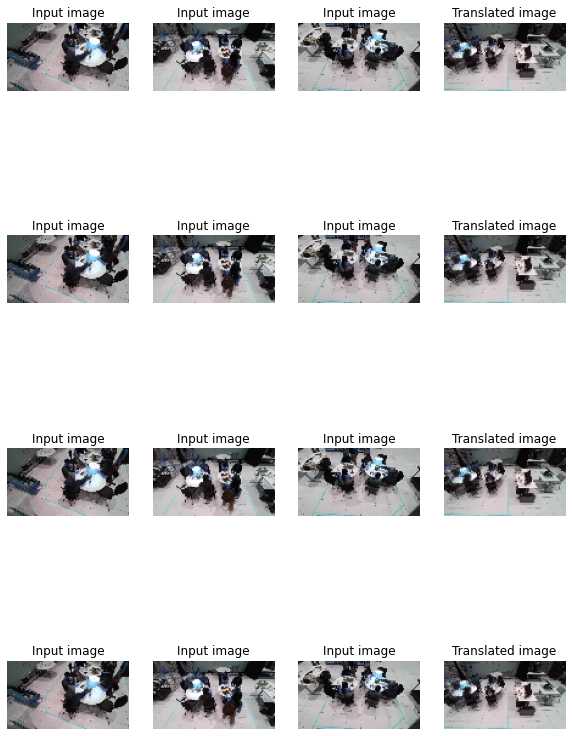

32/32 [==============================] - 77s 2s/step - set_loss: 4.0661 - D_set_loss: 2.4661e-05
Epoch 43/50
32/32 [==============================] - ETA: 0s - set_loss: 4.0145 - D_set_loss: 2.4762e-05

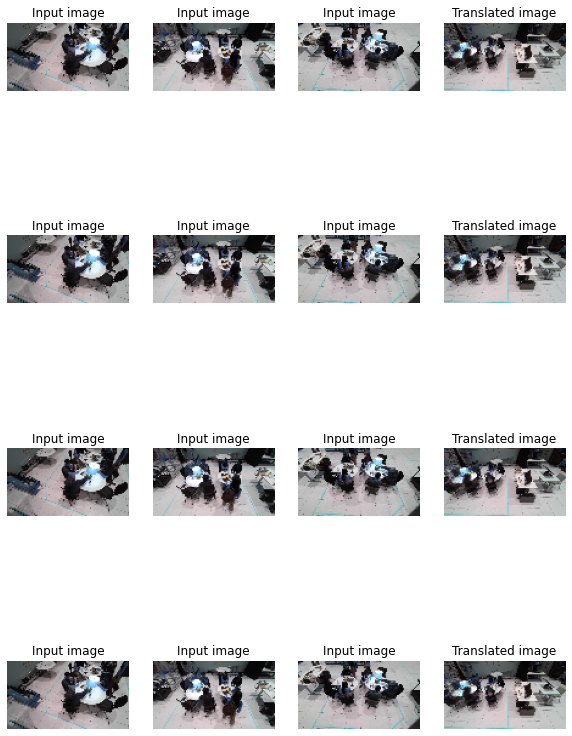

32/32 [==============================] - 77s 2s/step - set_loss: 4.0214 - D_set_loss: 2.4099e-05
Epoch 44/50
32/32 [==============================] - ETA: 0s - set_loss: 4.0036 - D_set_loss: 1.6636e-05

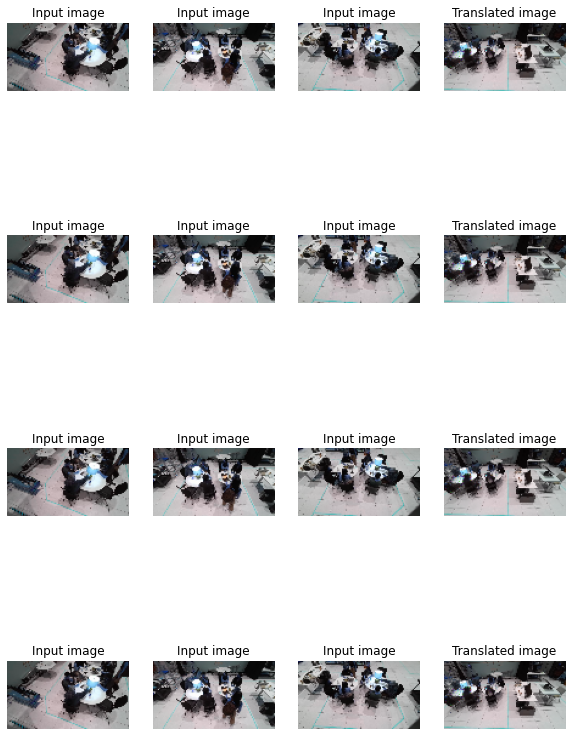

32/32 [==============================] - 77s 2s/step - set_loss: 4.0284 - D_set_loss: 1.6227e-05
Epoch 45/50
32/32 [==============================] - ETA: 0s - set_loss: 3.9805 - D_set_loss: 1.1863e-05

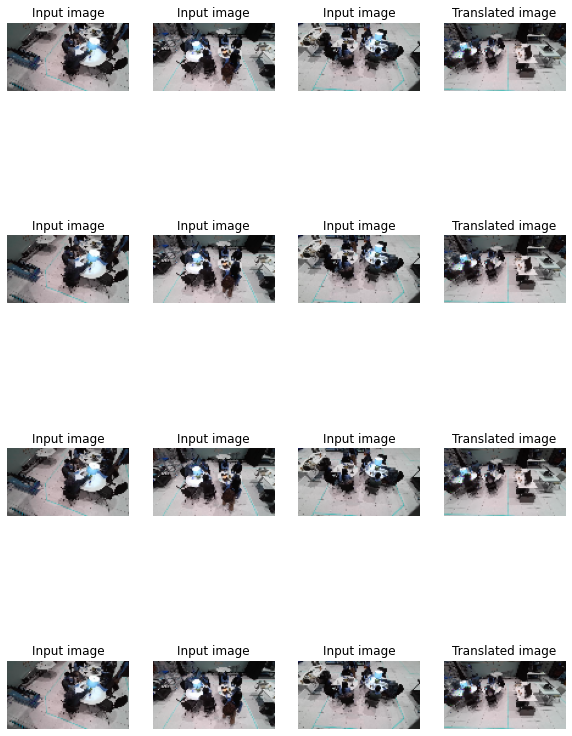

32/32 [==============================] - 77s 2s/step - set_loss: 3.9858 - D_set_loss: 1.1625e-05
Epoch 46/50
32/32 [==============================] - ETA: 0s - set_loss: 3.9590 - D_set_loss: 1.5568e-05

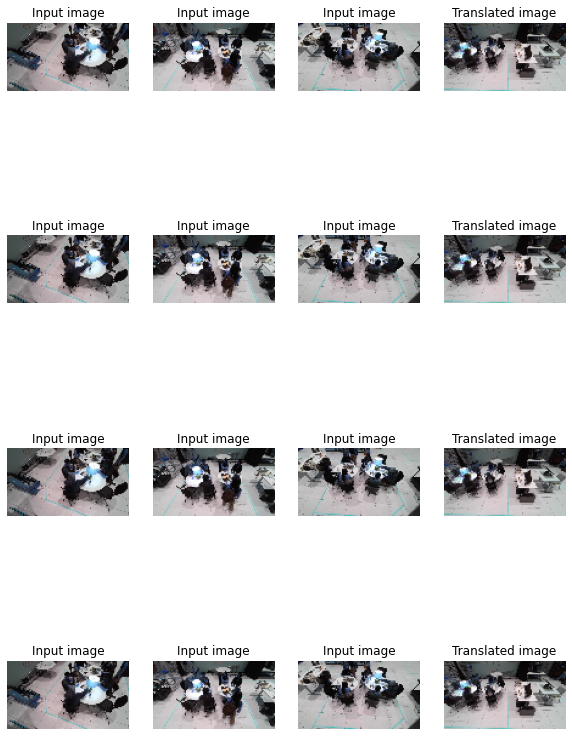

32/32 [==============================] - 77s 2s/step - set_loss: 3.9611 - D_set_loss: 1.5308e-05
Epoch 47/50
32/32 [==============================] - ETA: 0s - set_loss: 3.9616 - D_set_loss: 1.2797e-05

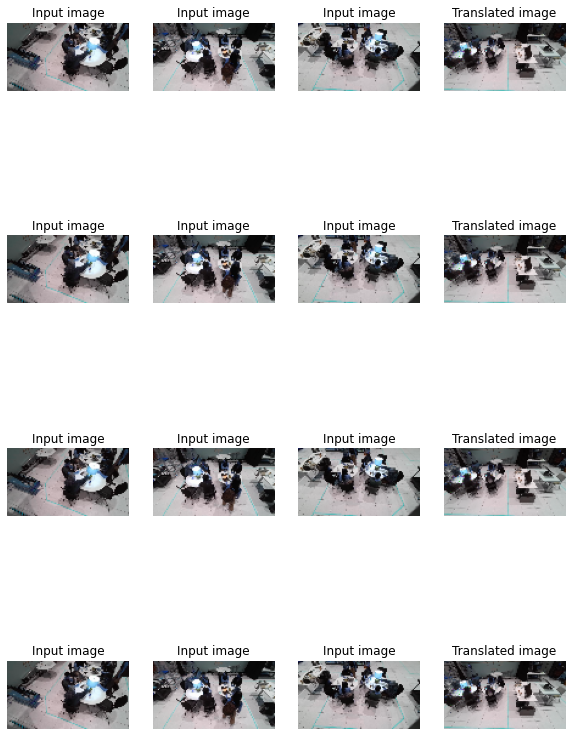

32/32 [==============================] - 77s 2s/step - set_loss: 3.9820 - D_set_loss: 1.2771e-05
Epoch 48/50
32/32 [==============================] - ETA: 0s - set_loss: 3.9535 - D_set_loss: 2.9524e-05

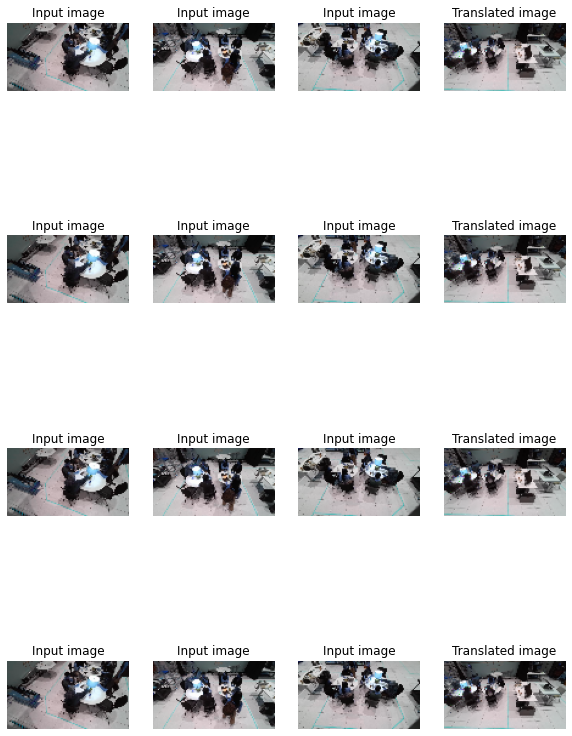

32/32 [==============================] - 77s 2s/step - set_loss: 3.9715 - D_set_loss: 2.9862e-05
Epoch 49/50
32/32 [==============================] - ETA: 0s - set_loss: 3.9375 - D_set_loss: 4.9428e-04

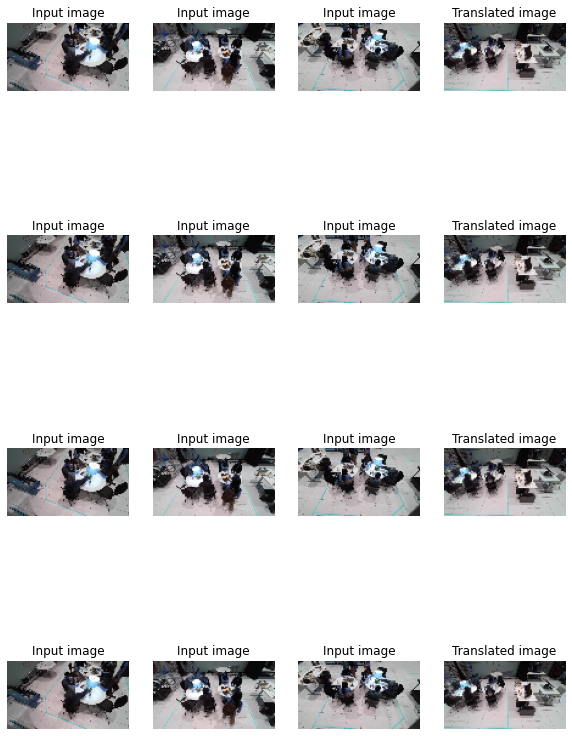

32/32 [==============================] - 77s 2s/step - set_loss: 3.9470 - D_set_loss: 4.9575e-04
Epoch 50/50
32/32 [==============================] - ETA: 0s - set_loss: 4.0864 - D_set_loss: 0.0087

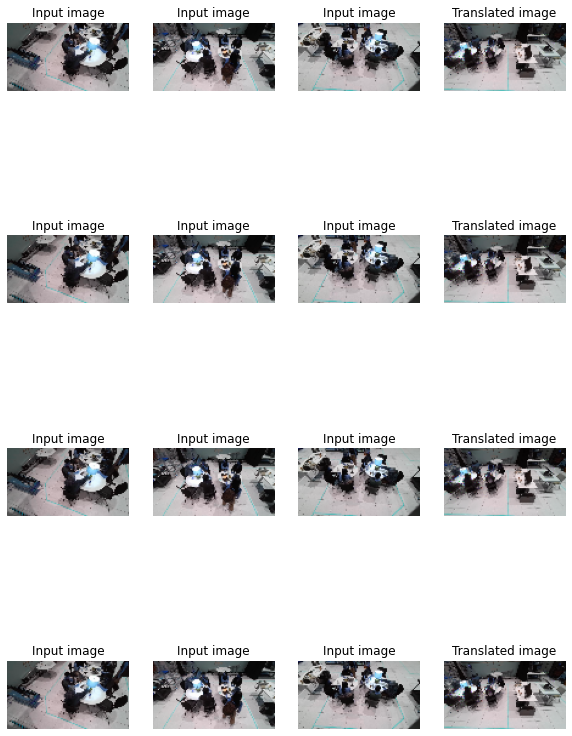

32/32 [==============================] - 77s 2s/step - set_loss: 4.0798 - D_set_loss: 0.0085


In [ ]:

# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5


# Create cycle gan model
'''
cycle_gan_model = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)
'''
cycle_gan_model = CycleGan(
    generator_X=gen_X, 
    generator_Y=gen_Y, 
    generator_Z=gen_Z, 
    generator_W=gen_W, 
    discriminator_X=disc_X, 
    discriminator_Y=disc_Y,
    discriminator_Z=disc_Z, 
    discriminator_W=disc_W,
    discriminator_set=disc_set
)
# Compile the model
'''
cycle_gan_model.compile(
    gen_G_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
'''
cycle_gan_model.compile(
    gen_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_Z_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_W_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_Z_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_W_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    disc_set_optimizer=keras.optimizers.Adam(learning_rate=2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()
#checkpoint_filepath = "./model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
checkpoint_filepath = "/content/drive/MyDrive/Research/model_checkpoints/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath
)

# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
cycle_gan_model.fit(
    tf.data.Dataset.zip((train_angles_3, train_angles_1)),
    epochs=50,
    #callbacks=[plotter, model_checkpoint_callback],
    callbacks=[plotter]
)

Test the performance of the model.

In [ ]:

# This model was trained for 90 epochs. We will be loading those weights
# here. Once the weights are loaded, we will take a few samples from the test
# data and check the model's performance.

In [ ]:

# Load the checkpoints
#weight_file = "./saved_checkpoints/cyclegan_checkpoints.090"
#cycle_gan_model.load_weights(weight_file).expect_partial()
#print("Weights loaded successfully")

#_, ax = plt.subplots(4, 2, figsize=(10, 15))
for i, img in enumerate(zip(test_angles_3, test_angles_1)):
    batch_size = tf.shape(img)[0][0]
    z_noise = tf.random.normal(shape=(batch_size, 512))
    prediction = cycle_gan_model.gen_Z([img[0],z_noise], training=False)[0][0].numpy()
    #print(img[0].shape)
    #print(img[1].shape)
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8) # predicted image
    img = (img[1][0][0] * 127.5 + 127.5).numpy().astype(np.uint8) # real image
    '''
    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction)
    ax[i, 0].set_title("Input image")
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")
    '''
    prediction = keras.preprocessing.image.array_to_img(prediction)
    real = keras.preprocessing.image.array_to_img(img)
    prediction.save("/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs_noise/mult_predicted_img_{i}.jpg".format(i=i))
    real.save("/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs_noise/mult_real_img_{i}.jpg".format(i=i))
#plt.tight_layout()
#plt.show()


In [ ]:
import glob
from PIL import Image

In [ ]:
# filepaths
#fp_in = "/path/to/image_*.png"
#fp_in = "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_0_*.png"
fp_in = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs_noise/mult_predicted_img_*.png"
#fp_in = "/content/predicted_img_*.png"
#fp_out = "/path/to/image.gif"
fp_out = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_predicted_mult_3to1_noise.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=500, loop=0)

In [ ]:
# filepaths
#fp_in = "/path/to/image_*.png"
#fp_in = "/content/drive/MyDrive/Research/CycleGAN_imgs/generated_img_0_*.png"
fp_in = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_3to1_imgs_noise/mult_real_img_*.png"
#fp_in = "/content/predicted_img_*.png"
#fp_out = "/path/to/image.gif"
fp_out = "/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_real_mult_3to1_noise.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=500, loop=0)

In [ ]:
from IPython.display import display, Image
A = Image(open('/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_predicted_mult_3to1_noise.gif','rb').read())
B = Image(open('/content/drive/MyDrive/Research/CycleGAN_Gifs/CycleGAN_real_mult_3to1_noise.gif','rb').read())

In [ ]:
display(A)
display(B)

In [ ]:
from tensorflow.python.ops.gen_dataset_ops import zip_dataset
_, ax = plt.subplots(4, 4, figsize=(10, 15))
for i, img in enumerate(zip(test_angles_3.take(1), test_angles_1.take(1))):
    batch_size = tf.shape(img)[0][0]
    z_noise = tf.random.normal(shape=(batch_size, 512))
    W,X,Y,Z = img[0][0][0],img[0][0][1],img[0][0][2],img[1][0][0]
    input1 = [W,X,Y] # W,X,Y -> Z
    input1 = tf.expand_dims(tf.stack(input1,axis=0), axis=0)
    input2 = [X,Y,Z] # X,Y,Z -> W
    input2 = tf.expand_dims(tf.stack(input2,axis=0), axis=0)
    input3 = [W,Y,Z] # W,Y,Z -> X
    input3 = tf.expand_dims(tf.stack(input3,axis=0), axis=0)
    input4 = [W,X,Z] # W,X,Z -> Y
    input4 = tf.expand_dims(tf.stack(input4,axis=0), axis=0)
    #print(input1.shape)
    #print(img[0].shape)
    prediction1 = cycle_gan_model.gen_Z([input1,z_noise], training=False)[0][0].numpy()
    prediction2 = cycle_gan_model.gen_W([input2,z_noise], training=False)[0][0].numpy()
    prediction3 = cycle_gan_model.gen_X([input3,z_noise], training=False)[0][0].numpy()
    prediction4 = cycle_gan_model.gen_Y([input4,z_noise], training=False)[0][0].numpy()
    #print(img[0].shape)
    #print(img[1].shape)
    prediction1 = (prediction1 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction2 = (prediction2 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction3 = (prediction3 * 127.5 + 127.5).astype(np.uint8) # predicted image
    prediction4 = (prediction4 * 127.5 + 127.5).astype(np.uint8) # predicted image
    X = (X * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    Y = (Y * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    Z = (Z * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    W = (W * 127.5 + 127.5).numpy().astype(np.uint8) # real image input
    
    ax[0, 0].imshow(W)
    ax[0, 1].imshow(X)
    ax[0, 2].imshow(Y)
    ax[0, 3].imshow(prediction1)
    ax[0, 0].set_title("Input image W")
    ax[0, 1].set_title("Input image X")
    ax[0, 2].set_title("Input image Y")
    ax[0, 3].set_title("Translated image Z")

    ax[1, 0].imshow(X)
    ax[1, 1].imshow(Y)
    ax[1, 2].imshow(Z)
    ax[1, 3].imshow(prediction2)
    ax[1, 0].set_title("Input image X")
    ax[1, 1].set_title("Input image Y")
    ax[1, 2].set_title("Input image Z")
    ax[1, 3].set_title("Translated image W")

    ax[2, 0].imshow(W)
    ax[2, 1].imshow(Y)
    ax[2, 2].imshow(Z)
    ax[2, 3].imshow(prediction3)
    ax[2, 0].set_title("Input image W")
    ax[2, 1].set_title("Input image Y")
    ax[2, 2].set_title("Input image Z")
    ax[2, 3].set_title("Translated image X")
    #ax[i, 0].axis("off")
    #ax[i, 1].axis("off")

    ax[3, 0].imshow(W)
    ax[3, 1].imshow(X)
    ax[3, 2].imshow(Z)
    ax[3, 3].imshow(prediction4)
    ax[3, 0].set_title("Input image W")
    ax[3, 1].set_title("Input image X")
    ax[3, 2].set_title("Input image Z")
    ax[3, 3].set_title("Translated image Y")
    
plt.show()
plt.close()

In [ ]:
t3,t1 = test_angles_3.take(200),test_angles_1.take(200)

In [ ]:
dataset_t3, dataset_t1 = list(t3.as_numpy_iterator()), list(t1.as_numpy_iterator())

In [ ]:
len(t3), len(t1)

In [ ]:
_, ax = plt.subplots(20, 2, figsize=(100, 150))
for i in range(20):
  prediction = cycle_gan_model.gen_Z(dataset_t3[i], training=False)
  prediction = prediction.numpy()
  real = np.array(dataset_t1)
  prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
  real = (real * 127.5 + 127.5).astype(np.uint8)
  ax[i,0].imshow(tf.squeeze(prediction))
  ax[i,1].imshow(tf.squeeze(real)[i])
plt.show()

In [ ]:
for element in t3:
  prediction = cycle_gan_model.gen_Z(element, training=False)
  prediction = tf.squeeze(prediction)
  #prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
  plt.imshow(prediction)

In [ ]:
prediction1 = cycle_gan_model.gen_Z(t3, training=False)